# Results analysis

This notebook provides all the quantitative and qualitative results presented in the paper.

Opening the files stored at drive and check if they are being loaded correctly.



In [ ]:
from google.colab import drive
import os

drive.mount('/content/drive')

path = r'/content/drive/My Drive/MAI/OR/Fashionpedia/'

import zipfile

zip_ref = zipfile.ZipFile(path + "test.zip", 'r')
zip_ref.extractall("")
zip_ref.close()

zip_ref = zipfile.ZipFile(path + "val.zip", 'r')
zip_ref.extractall("")
zip_ref.close()

zip_ref = zipfile.ZipFile(path + "train.zip", 'r')
zip_ref.extractall("")
zip_ref.close()

zip_ref = zipfile.ZipFile(path + "seg_val.zip", 'r')
zip_ref.extractall("")
zip_ref.close()

zip_ref = zipfile.ZipFile(path + "seg_train.zip", 'r')
zip_ref.extractall("")
zip_ref.close()

print('Train contains:', len(os.listdir('/content/train/')), 'images')
print('Seg_train contains:',len(os.listdir('/content/seg_train/')), 'images')
print('Validation contains:',len(os.listdir('/content/val/')), 'images')
print('Seg_val contains:',len(os.listdir('/content/seg_val/')), 'images')
print('Test contains:',len(os.listdir('/content/test/')), 'images')

Mounted at /content/drive
Train contains: 45623 images
Seg_train contains: 45623 images
Validation contains: 1158 images
Seg_val contains: 1158 images
Test contains: 2042 images


## Importing and installing all the necessary libraries

In [ ]:
# Install PyTorch
!conda install pytorch==1.12.0 torchvision==0.13.0 torchaudio==0.12.0 cudatoolkit=11.3 -c pytorch
# Install mim
!pip install -U openmim
# Install mmengine
!mim install mmengine
# Install MMCV
!mim install 'mmcv >= 2.0.0rc1'
!rm -rf mmsegmentation
!git clone -b main https://github.com/open-mmlab/mmsegmentation.git 
%cd mmsegmentation
!pip install -e .


import torch, torchvision
import mmseg
import mmcv
import mmengine

/bin/bash: conda: command not found
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.3/51.3 kB 4.3 MB/s eta 0:00:00
/usr/local/lib/python3.9/dist-packages/setuptools/command/install.py:34: SetuptoolsDeprecationWarning: setup.py install is deprecated. Use build and pip and other standards-based tools.
  warnings.warn(
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.openmmlab.com/mmcv/dist/cu118/torch2.0.0/index.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 366.9/366.9 kB 12.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 200.9/200.9 kB 25.2 MB/s eta 0:00:00
/usr/local/lib/python3.9/dist-packages/setuptools/command/install.py:34: SetuptoolsDeprecationWarning: setup.py install is deprecated. Use build and pip and other standards-based tools.
  warnings.warn(
/usr/local/lib/python3.9/dist-p

Functions for plotting the results:

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib.colors import ListedColormap
import numpy as np
import matplotlib.patches as mpatches
from PIL import Image


def calc_cmap(labels):
    color_list = ['#050505', '#ba1414', '#59e346', '#3096c2', '#be29cc', '#ed9b4e', '#faed61', '#184cc7', '#1c5b75',
        '#289e4d', '#164d41', '#f04943', '#c24640', '#6cb5d4', '#e9eef0', '#01063d', '#bf02a6', '#02bf3b',
        '#ffb938', '#b5b2ac', '#ad7102', '#ffffff', '#e0e0e0', '#e9f7f4', '#474241', '#db998a', '#8d8adb',
        '#ce8adb', '#3096c2', '#ffd700', '#f2e0ac', '#ffc014', '#f7f2e4', '#4eba64', '#b1fac0', '#fbff1f',
        '#cfcfcf', '#e334b7', '#ff8b47', '#fc311e', '#f768eb', '#7cfcf4', '#eb4542', '#f9ff42', '#f55663',
        '#d9d9d4', '#d2d498']
    max_class = np.max(np.unique(labels))
    return color_list[:max_class+1]

def plot_segmentation(image):

    fashionpedia_dic = {
        0:'Background', 1:'shirt, blouse', 2:'top, t-shirt, sweatshirt', 3:'sweater', 4:'cardigan', 5:'jacket',
        6:'vest', 7:'pants', 8:'shorts', 9:'skirt', 10: 'coat', 11: 'dress', 12: 'jumpsuit', 13: 'cape',
        14: 'glasses', 15: 'hat', 16: 'headband, hair accessory', 17: 'tie', 18: 'glove', 19: 'watch', 20: 'belt',
        21: 'leg warmer',22: 'tights, stockings',23: 'sock',24:'shoe',25:'bag, wallet',26:'scarf',27:'umbrella',
        28: 'hood', 29:'collar', 30:'lapel', 31: 'epaulette',32:'sleeve',33:'pocket',34:'neckline',35:'buckle',
        36: 'zipper', 37: 'applique', 38: 'bead', 39:'bow', 40:'flower', 41: 'fringe', 42:'ribbon', 43:'rivet',
        44: 'ruffle', 45:'sequin', 46:'tassel'
    }

    cmap = ListedColormap(calc_cmap(image))

    plt.figure(figsize=(10,10))
    vals = np.unique(image)
    im = plt.imshow(image, cmap = cmap)
    colors = [ im.cmap(im.norm(value)) for value in vals]
    labels = [ mpatches.Patch(color = colors[i], label = fashionpedia_dic[vals[i]] ) for i in range(len(vals)) ]
    plt.legend(handles = labels, bbox_to_anchor = (1.02, 1), loc = 2, borderaxespad = 0. )
    plt.axis('off')
    plt.show()

def overlay_segmentation(image, mask, title):

    fashionpedia_dic = {
        0:'Background', 1:'shirt, blouse', 2:'top, t-shirt, sweatshirt', 3:'sweater', 4:'cardigan', 5:'jacket',
        6:'vest', 7:'pants', 8:'shorts', 9:'skirt', 10: 'coat', 11: 'dress', 12: 'jumpsuit', 13: 'cape',
        14: 'glasses', 15: 'hat', 16: 'headband, hair accessory', 17: 'tie', 18: 'glove', 19: 'watch', 20: 'belt',
        21: 'leg warmer',22: 'tights, stockings',23: 'sock',24:'shoe',25:'bag, wallet',26:'scarf',27:'umbrella',
        28: 'hood', 29:'collar', 30:'lapel', 31: 'epaulette',32:'sleeve',33:'pocket',34:'neckline',35:'buckle',
        36: 'zipper', 37: 'applique', 38: 'bead', 39:'bow', 40:'flower', 41: 'fringe', 42:'ribbon', 43:'rivet',
        44: 'ruffle', 45:'sequin', 46:'tassel'
    }

    cmap = ListedColormap(calc_cmap(mask))

    plt.figure(figsize=(10,10))
    vals = np.unique(mask)
    im = plt.imshow(mask, cmap = cmap)
    colors = [ im.cmap(im.norm(value)) for value in vals]
    labels = [ mpatches.Patch(color = colors[i], label = fashionpedia_dic[vals[i]] ) for i in range(len(vals)) ]
    plt.imshow(image, alpha = 0.3)
    plt.title(title)
    plt.legend(handles = labels, bbox_to_anchor = (1.02, 1), loc = 2, borderaxespad = 0. )
    plt.axis('off')
    plt.show()

def label_printer(image):
  fashionpedia_dic = {
          0:'Background', 1:'shirt, blouse', 2:'top, t-shirt, sweatshirt', 3:'sweater', 4:'cardigan', 5:'jacket',
          6:'vest', 7:'pants', 8:'shorts', 9:'skirt', 10: 'coat', 11: 'dress', 12: 'jumpsuit', 13: 'cape',
          14: 'glasses', 15: 'hat', 16: 'headband, hair accessory', 17: 'tie', 18: 'glove', 19: 'watch', 20: 'belt',
          21: 'leg warmer',22: 'tights, stockings',23: 'sock',24:'shoe',25:'bag, wallet',26:'scarf',27:'umbrella',
          28: 'hood', 29:'collar', 30:'lapel', 31: 'epaulette',32:'sleeve',33:'pocket',34:'neckline',35:'buckle',
          36: 'zipper', 37: 'applique', 38: 'bead', 39:'bow', 40:'flower', 41: 'fringe', 42:'ribbon', 43:'rivet',
          44: 'ruffle', 45:'sequin', 46:'tassel'
      }
  print('Predicted labels are:' , [fashionpedia_dic[element] for element in np.unique(image)])

def compare_segmentation(path_im, path_gt):
  img = Image.open(path_im)
  img_seg = Image.open(path_gt)
  overlay_segmentation(img, img_seg, 'Ground truth')

  img_r = mmcv.imread(path_im)
  result = inference_model(model, img_r)
  mask = result.pred_sem_seg.cpu().numpy().data[0]

  overlay_segmentation(img, mask, 'Predicted mask')
  label_printer(mask)

In [ ]:
!nvidia-smi -L

GPU 0: Tesla T4 (UUID: GPU-9e2b7377-7d2d-cf05-9929-64eff91eaac7)


### Prepare the model
Download the R101-FPN model and prepare it to receive the Fashionpedia dataset.

We need to convert the annotation into semantic map format as an image.

In [ ]:
# define class and palette for better visualization
classes = ('Background', 'shirt, blouse','top, t-shirt, sweatshirt','sweater','cardigan','jacket', 'vest','pants','shorts','skirt', 'coat', 'dress', 'jumpsuit',
           'cape', 'glasses','hat','headband, hair accessory','tie', 'glove','watch','belt','leg warmer','tights, stockings','sock','shoe','bag, wallet','scarf',
           'umbrella','hood','collar','lapel', 'epaulette','sleeve', 'pocket', 'neckline','buckle','zipper','applique','bead','bow','flower','fringe','ribbon',
           'rivet', 'ruffle', 'sequin','tassel')
palette = [ [5, 5, 5],  [186, 20, 20],  [89, 227, 70],  [48, 150, 194],  [190, 41, 204],  [237, 155, 78],  [250, 237, 97],  [24, 76, 199],  [28, 91, 117],  
           [40, 158, 77],  [22, 77, 65],  [240, 73, 67],  [194, 70, 64],  [108, 181, 212],  [233, 238, 240],  [1, 6, 61],  [191, 2, 166],  [2, 191, 59], 
           [255, 185, 56],  [181, 178, 172],  [173, 113, 2],  [255, 255, 255],  [224, 224, 224],  [233, 247, 244],  [71, 66, 65],  [219, 153, 138],  
           [141, 138, 219],  [206, 138, 219],  [48, 150, 194],  [233, 250, 45],  [242, 224, 172],  [255, 192, 20],  [247, 242, 228],  [78, 186, 100],  
           [177, 250, 192],  [251, 255, 31],  [207, 207, 207],  [227, 52, 183],  [255, 139, 71],  [252, 49, 30],  [247, 104, 235],  [124, 252, 244],  
           [235, 69, 66],  [249, 255, 66],  [252, 255, 163],  [217, 217, 212],  [210, 212, 152]]

from mmseg.registry import DATASETS
from mmseg.datasets import BaseSegDataset

@DATASETS.register_module()
class FashionPediaDataset(BaseSegDataset):
  METAINFO = dict(classes = classes, palette = palette)
  def __init__(self, **kwargs):
    super().__init__(img_suffix='.jpg', seg_map_suffix='_seg.png', **kwargs)

In [ ]:
# Download config and checkpoint files
!mim download mmsegmentation --config pointrend_r101_4xb4-160k_ade20k-512x512 --dest .

processing pointrend_r101_4xb4-160k_ade20k-512x512...
downloading ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 183.2/183.2 MiB 9.8 MB/s eta 0:00:00
Successfully downloaded pointrend_r101_512x512_160k_ade20k_20200808_030852-8834902a.pth to /content/mmsegmentation
Successfully dumped pointrend_r101_4xb4-160k_ade20k-512x512.py to /content/mmsegmentation


In [ ]:
from mmengine import Config
cfg = Config.fromfile('configs/point_rend/pointrend_r101_4xb4-160k_ade20k-512x512.py')
print(f'Config:\n{cfg.pretty_text}')

Config:
norm_cfg = dict(type='SyncBN', requires_grad=True)
data_preprocessor = dict(
    type='SegDataPreProcessor',
    mean=[123.675, 116.28, 103.53],
    std=[58.395, 57.12, 57.375],
    bgr_to_rgb=True,
    pad_val=0,
    seg_pad_val=255,
    size=(512, 512))
model = dict(
    type='CascadeEncoderDecoder',
    data_preprocessor=dict(
        type='SegDataPreProcessor',
        mean=[123.675, 116.28, 103.53],
        std=[58.395, 57.12, 57.375],
        bgr_to_rgb=True,
        pad_val=0,
        seg_pad_val=255,
        size=(512, 512)),
    num_stages=2,
    pretrained='open-mmlab://resnet101_v1c',
    backbone=dict(
        type='ResNetV1c',
        depth=101,
        num_stages=4,
        out_indices=(0, 1, 2, 3),
        dilations=(1, 1, 1, 1),
        strides=(1, 2, 2, 2),
        norm_cfg=dict(type='SyncBN', requires_grad=True),
        norm_eval=False,
        style='pytorch',
        contract_dilation=True),
    neck=dict(
        type='FPN',
        in_channels=[256, 512, 

In [ ]:
data_root = '/content/'
data_prefix_train = dict(img_path='train', seg_map_path='seg_train')
data_prefix_val = dict(img_path='val', seg_map_path='seg_val')
data_prefix_test = dict(img_path='test')

cfg.norm_cfg = dict(type='BN', requires_grad=True)
cfg.crop_size = (256, 256)
cfg.model.data_preprocessor.size = cfg.crop_size
cfg.model.backbone.norm_cfg = cfg.norm_cfg
cfg.model.decode_head[0].num_classes = 47
cfg.model.decode_head[1].num_classes = 47

# Modify dataset type and path
cfg.dataset_type = 'FashionPediaDataset'
cfg.data_root = data_root

cfg.train_dataloader.batch_size = 32


cfg.train_pipeline = [
    dict(type='LoadImageFromFile'),
    dict(type='LoadAnnotations'),
    dict(type='Resize', scale=(256, 256), keep_ratio=True),
    dict(type='PhotoMetricDistortion'),
    dict(type='RandomCrop', crop_size=cfg.crop_size, cat_max_ratio=0.75),
    dict(type='RandomFlip', prob=0.5),
    dict(type='PackSegInputs')
]

cfg.test_pipeline = [
    dict(type='LoadImageFromFile'),
    dict(type='Resize', scale=(256, 256), keep_ratio=True),
    dict(type='LoadAnnotations'),
    dict(type='PackSegInputs')
]


cfg.train_dataloader.dataset.type = cfg.dataset_type
cfg.train_dataloader.dataset.data_root = cfg.data_root
cfg.train_dataloader.dataset.data_prefix = data_prefix_train 
cfg.train_dataloader.dataset.pipeline = cfg.train_pipeline

cfg.val_dataloader.dataset.type = cfg.dataset_type
cfg.val_dataloader.dataset.data_root = cfg.data_root
cfg.val_dataloader.dataset.data_prefix = data_prefix_val
cfg.val_dataloader.dataset.pipeline = cfg.test_pipeline

cfg.test_dataloader = cfg.val_dataloader

# Set up working dir to save files and logs.
cfg.work_dir = './work_dirs/checkpoints'
cfg.load_from = '/content/drive/My Drive/MAI/OR/Fashionpedia/iter_28000.pth'

cfg.train_cfg.max_iters = 30000
cfg.train_cfg.val_interval = 500
cfg.default_hooks.logger.interval = 10
cfg.default_hooks.checkpoint.interval = 500

# Set seed to facilitate reproducing the result
cfg['randomness'] = dict(seed=0)

# Let's have a look at the final config used for training
print(f'Config:\n{cfg.pretty_text}')

Config:
norm_cfg = dict(type='BN', requires_grad=True)
data_preprocessor = dict(
    type='SegDataPreProcessor',
    mean=[123.675, 116.28, 103.53],
    std=[58.395, 57.12, 57.375],
    bgr_to_rgb=True,
    pad_val=0,
    seg_pad_val=255,
    size=(512, 512))
model = dict(
    type='CascadeEncoderDecoder',
    data_preprocessor=dict(
        type='SegDataPreProcessor',
        mean=[123.675, 116.28, 103.53],
        std=[58.395, 57.12, 57.375],
        bgr_to_rgb=True,
        pad_val=0,
        seg_pad_val=255,
        size=(256, 256)),
    num_stages=2,
    pretrained='open-mmlab://resnet101_v1c',
    backbone=dict(
        type='ResNetV1c',
        depth=101,
        num_stages=4,
        out_indices=(0, 1, 2, 3),
        dilations=(1, 1, 1, 1),
        strides=(1, 2, 2, 2),
        norm_cfg=dict(type='BN', requires_grad=True),
        norm_eval=False,
        style='pytorch',
        contract_dilation=True),
    neck=dict(
        type='FPN',
        in_channels=[256, 512, 1024, 20

In [ ]:
from mmengine.runner import Runner

runner = Runner.from_cfg(cfg)

04/24 14:39:13 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: linux
    Python: 3.9.16 (main, Dec  7 2022, 01:11:51) [GCC 9.4.0]
    CUDA available: True
    numpy_random_seed: 0
    GPU 0: Tesla T4
    CUDA_HOME: /usr/local/cuda
    NVCC: Cuda compilation tools, release 11.8, V11.8.89
    GCC: x86_64-linux-gnu-gcc (Ubuntu 9.4.0-1ubuntu1~20.04.1) 9.4.0
    PyTorch: 2.0.0+cu118
    PyTorch compiling details: PyTorch built with:
  - GCC 9.3
  - C++ Version: 201703
  - Intel(R) oneAPI Math Kernel Library Version 2022.2-Product Build 20220804 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v2.7.3 (Git Hash 6dbeffbae1f23cbbeae17adb7b5b13f1f37c080e)
  - OpenMP 201511 (a.k.a. OpenMP 4.5)
  - LAPACK is enabled (usually provided by MKL)
  - NNPACK is enabled
  - CPU capability usage: AVX2
  - CUDA Runtime 11.8
  - NVCC architecture flags: -gencode;arch=compute_37,code=sm_37;-gencode;arch=compute_50,code=sm_5

/content/mmsegmentation/mmseg/models/backbones/resnet.py:431: UserWarning: DeprecationWarning: pretrained is a deprecated, please use "init_cfg" instead
  warnings.warn('DeprecationWarning: pretrained is a deprecated, '
/content/mmsegmentation/mmseg/models/builder.py:36: UserWarning: ``build_loss`` would be deprecated soon, please use ``mmseg.registry.MODELS.build()`` 
  warnings.warn('``build_loss`` would be deprecated soon, please use '
/content/mmsegmentation/mmseg/models/losses/cross_entropy_loss.py:235: UserWarning: Default ``avg_non_ignore`` is False, if you would like to ignore the certain label and average loss over non-ignore labels, which is the same with PyTorch official cross_entropy, set ``avg_non_ignore=True``.
  warnings.warn(


04/24 14:39:21 - mmengine - INFO - Distributed training is not used, all SyncBatchNorm (SyncBN) layers in the model will be automatically reverted to BatchNormXd layers if they are used.
04/24 14:39:21 - mmengine - INFO - Hooks will be executed in the following order:
before_run:
(VERY_HIGH   ) RuntimeInfoHook                    
(BELOW_NORMAL) LoggerHook                         
 -------------------- 
before_train:
(VERY_HIGH   ) RuntimeInfoHook                    
(NORMAL      ) IterTimerHook                      
(VERY_LOW    ) CheckpointHook                     
 -------------------- 
before_train_epoch:
(VERY_HIGH   ) RuntimeInfoHook                    
(NORMAL      ) IterTimerHook                      
(NORMAL      ) DistSamplerSeedHook                
 -------------------- 
before_train_iter:
(VERY_HIGH   ) RuntimeInfoHook                    
(NORMAL      ) IterTimerHook                      
 -------------------- 
after_train_iter:
(VERY_HIGH   ) RuntimeInfoHook                

/content/mmsegmentation/mmseg/engine/hooks/visualization_hook.py:61: UserWarning: The draw is False, it means that the hook for visualization will not take effect. The results will NOT be visualized or stored.
  warnings.warn('The draw is False, it means that the '


Use the method test to evaluate the results on validation data.

In [ ]:
# Checking the results
runner.test()

04/24 13:19:10 - mmengine - WARNING - The prefix is not set in metric class IoUMetric.


/usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:561: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


Loads checkpoint by local backend from path: /content/drive/My Drive/MAI/OR/Fashionpedia/iter_28000.pth
04/24 13:19:17 - mmengine - INFO - Load checkpoint from /content/drive/My Drive/MAI/OR/Fashionpedia/iter_28000.pth


/usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:561: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


04/24 13:19:27 - mmengine - INFO - Iter(test) [  10/1158]    eta: 0:16:59  time: 0.8885  data_time: 0.0508  memory: 8557  
04/24 13:19:33 - mmengine - INFO - Iter(test) [  20/1158]    eta: 0:15:37  time: 0.7588  data_time: 0.1881  memory: 8560  
04/24 13:19:35 - mmengine - INFO - Iter(test) [  30/1158]    eta: 0:11:28  time: 0.1836  data_time: 0.0123  memory: 8559  
04/24 13:19:37 - mmengine - INFO - Iter(test) [  40/1158]    eta: 0:09:36  time: 0.2309  data_time: 0.0046  memory: 8557  
04/24 13:19:38 - mmengine - INFO - Iter(test) [  50/1158]    eta: 0:07:45  time: 0.0389  data_time: 0.0042  memory: 1243  
04/24 13:19:40 - mmengine - INFO - Iter(test) [  60/1158]    eta: 0:06:56  time: 0.1770  data_time: 0.0053  memory: 8560  
04/24 13:19:42 - mmengine - INFO - Iter(test) [  70/1158]    eta: 0:06:25  time: 0.1994  data_time: 0.0036  memory: 8558  
04/24 13:19:43 - mmengine - INFO - Iter(test) [  80/1158]    eta: 0:05:45  time: 0.0873  data_time: 0.0037  memory: 8557  
04/24 13:19:43 -

{'aAcc': 94.39, 'mIoU': 24.18, 'mAcc': 30.61}

In [ ]:
from mmseg.apis import init_model, inference_model, show_result_pyplot

# Init the model from the config and the checkpoint
checkpoint_path = '/content/drive/My Drive/MAI/OR/Fashionpedia/iter_28000.pth'
model = init_model(cfg, checkpoint_path, 'cuda:0')

Loads checkpoint by local backend from path: /content/drive/My Drive/MAI/OR/Fashionpedia/iter_28000.pth


### Validation examples for best segmented classes

#### Dresses:

----------eb20c87403d09323d402b3461afbdb0e----------


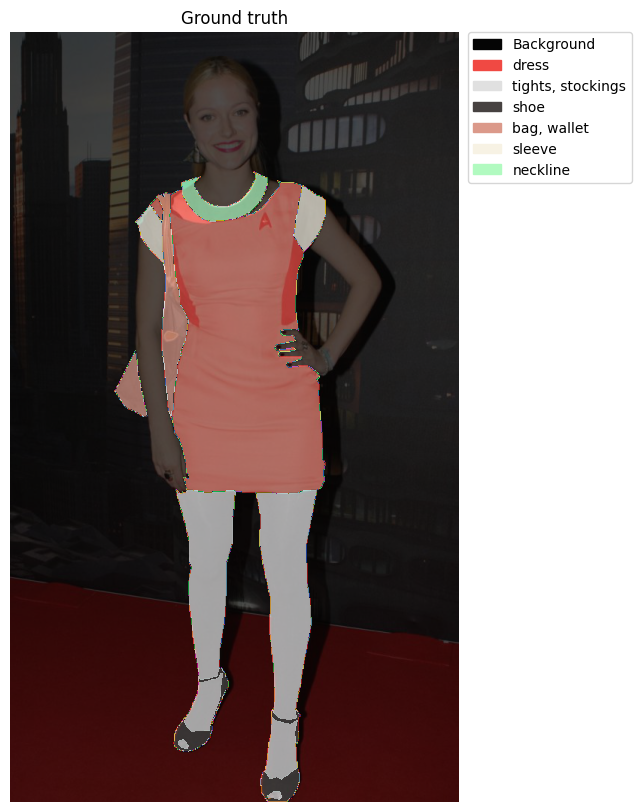

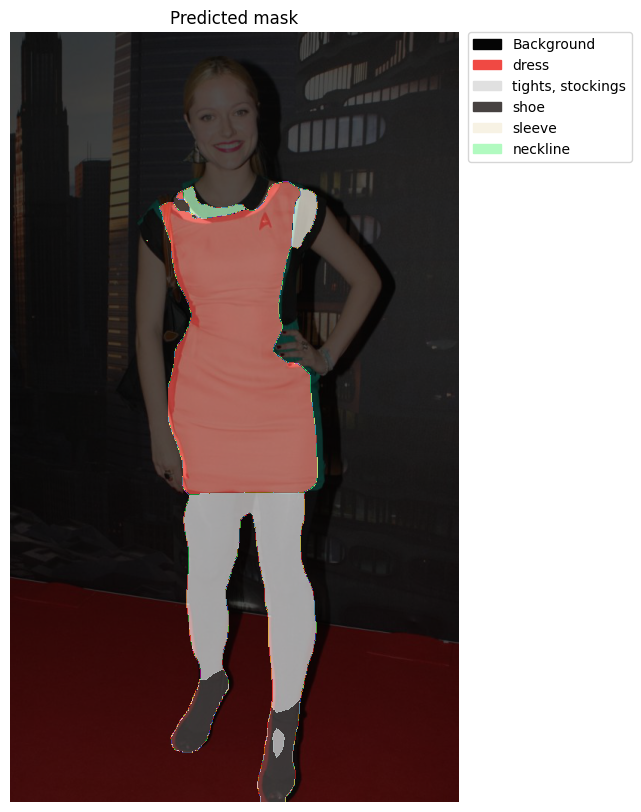

Predicted labels are: ['Background', 'dress', 'tights, stockings', 'shoe', 'sleeve', 'neckline']
----------02182c58daf61dc5c5c64bb112b1f826----------


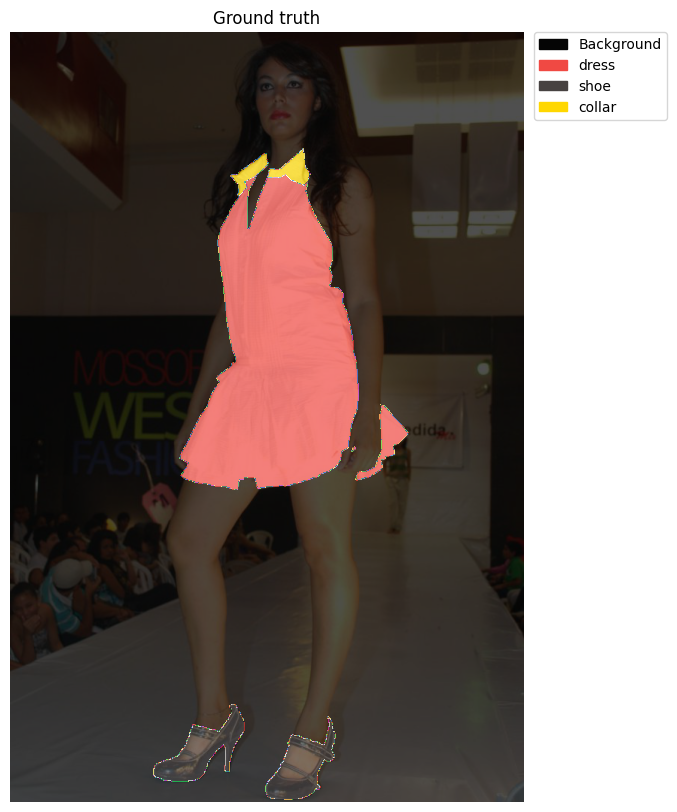

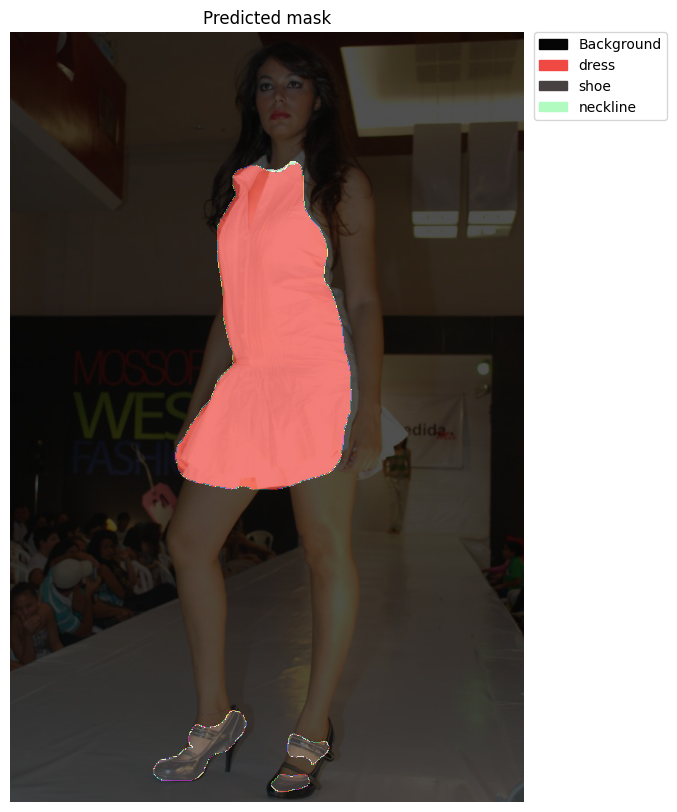

Predicted labels are: ['Background', 'dress', 'shoe', 'neckline']
----------0349e23c22d9ab9a482ac3d38ec315d5----------


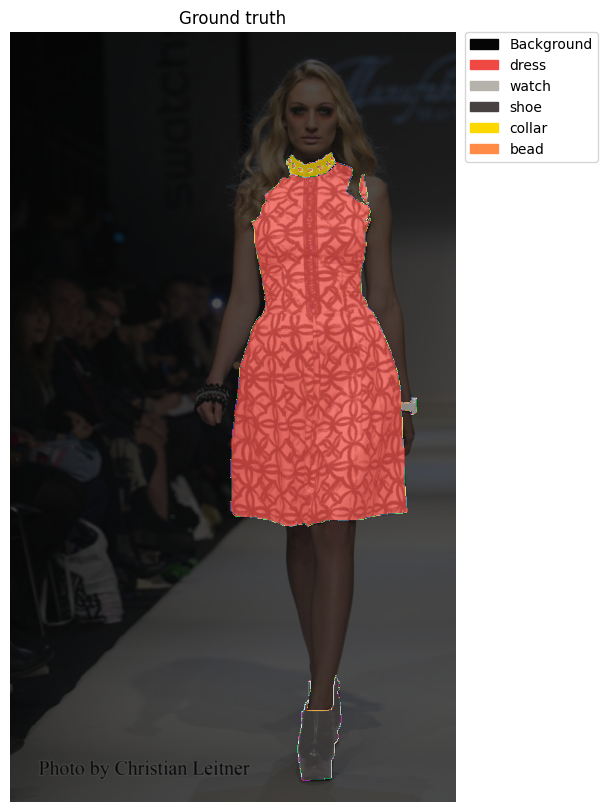

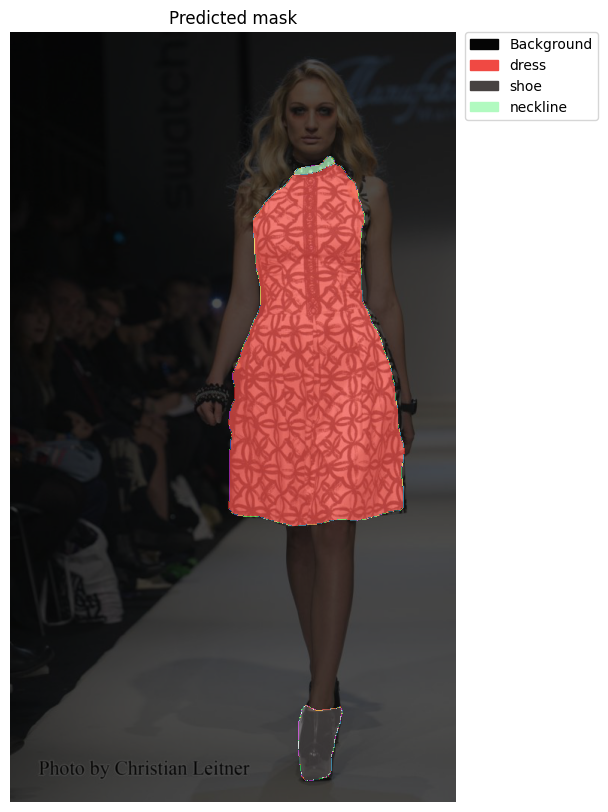

Predicted labels are: ['Background', 'dress', 'shoe', 'neckline']
----------0420c7e0454fbbe11fadd23eb1f40d38----------


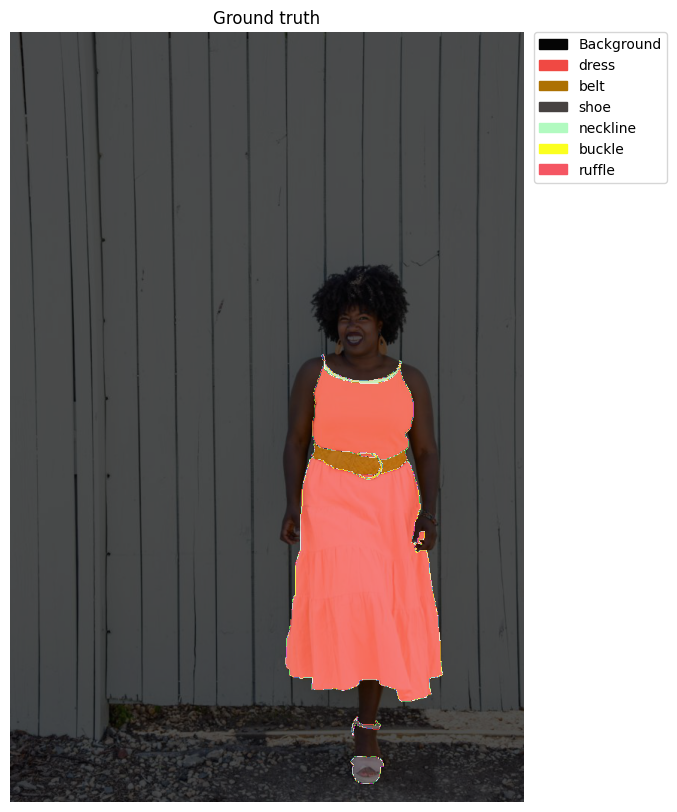

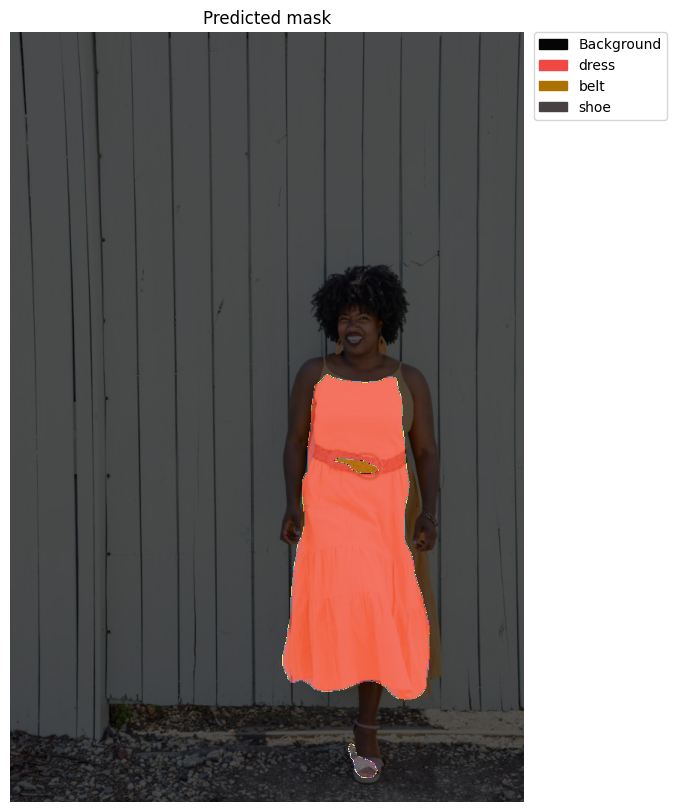

Predicted labels are: ['Background', 'dress', 'belt', 'shoe']
----------0483fc73ee89d2e8c4b63aeb3af0542c----------


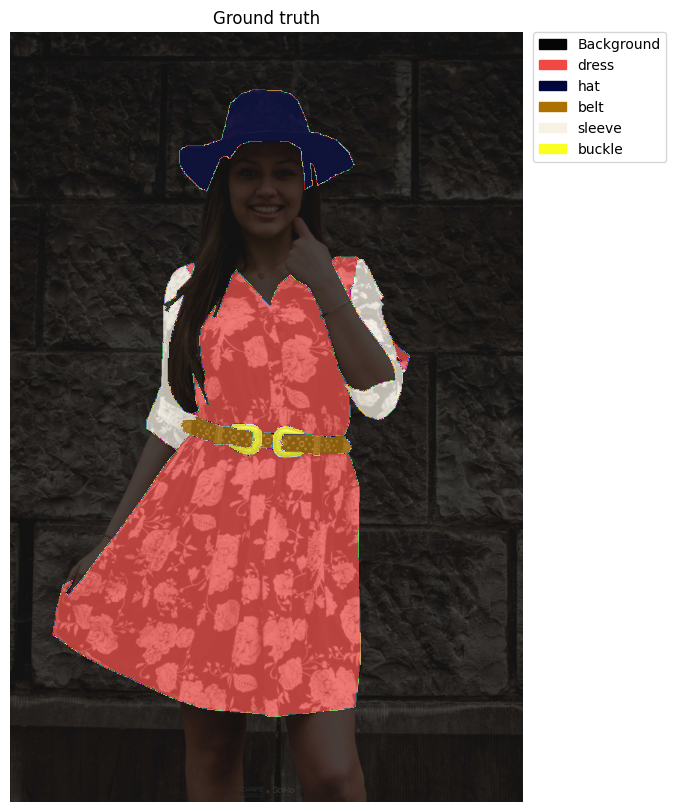

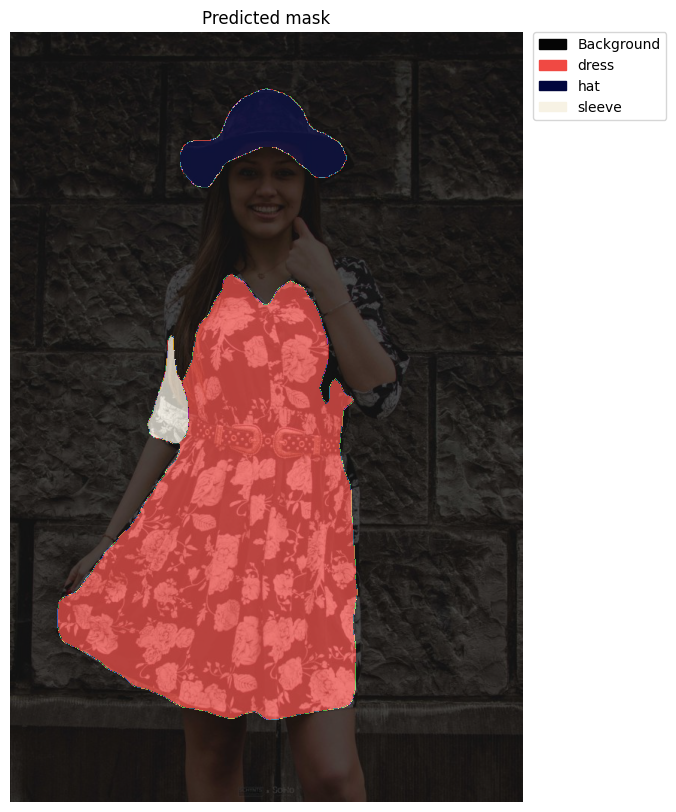

Predicted labels are: ['Background', 'dress', 'hat', 'sleeve']
----------d7f4d06c3226febd8569d92476c19ef1----------


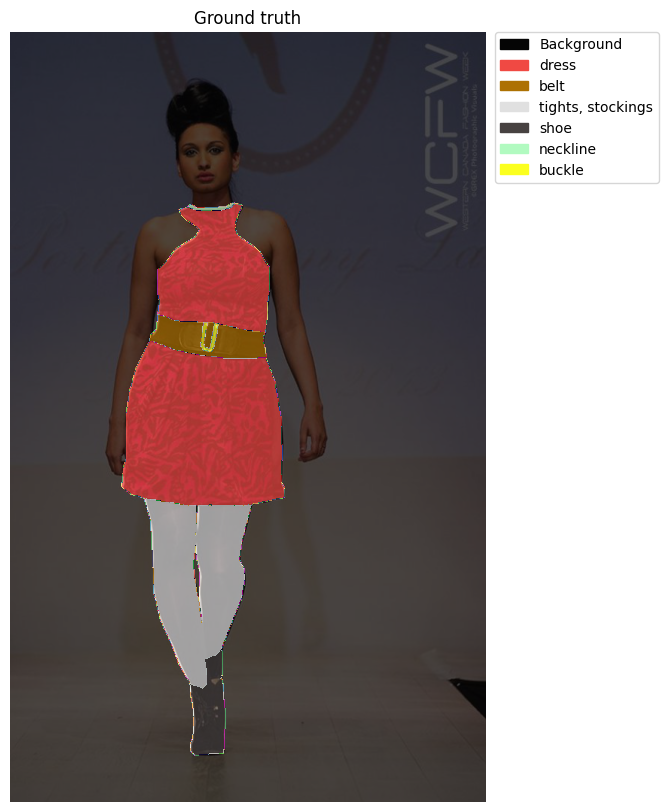

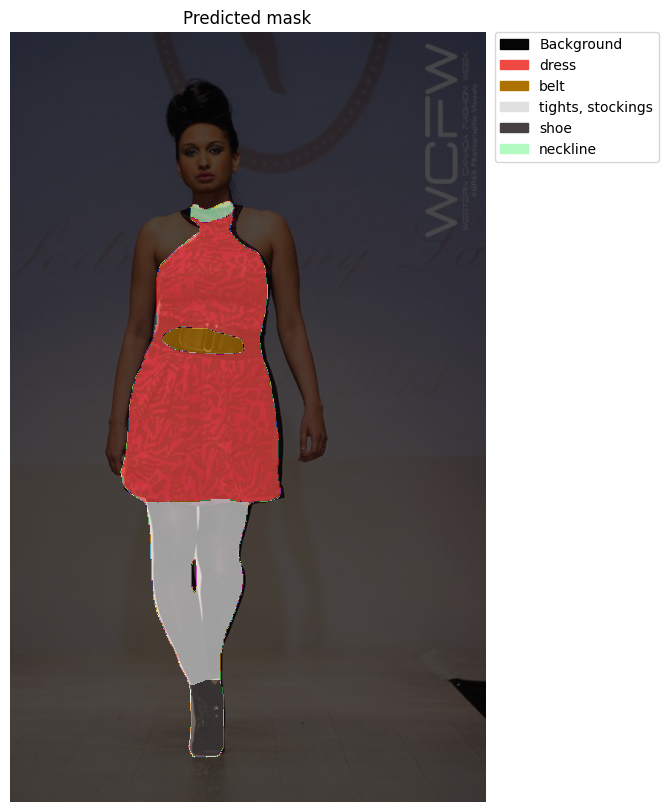

Predicted labels are: ['Background', 'dress', 'belt', 'tights, stockings', 'shoe', 'neckline']
----------069223d02dcbfbe69af905daeb7fae26----------


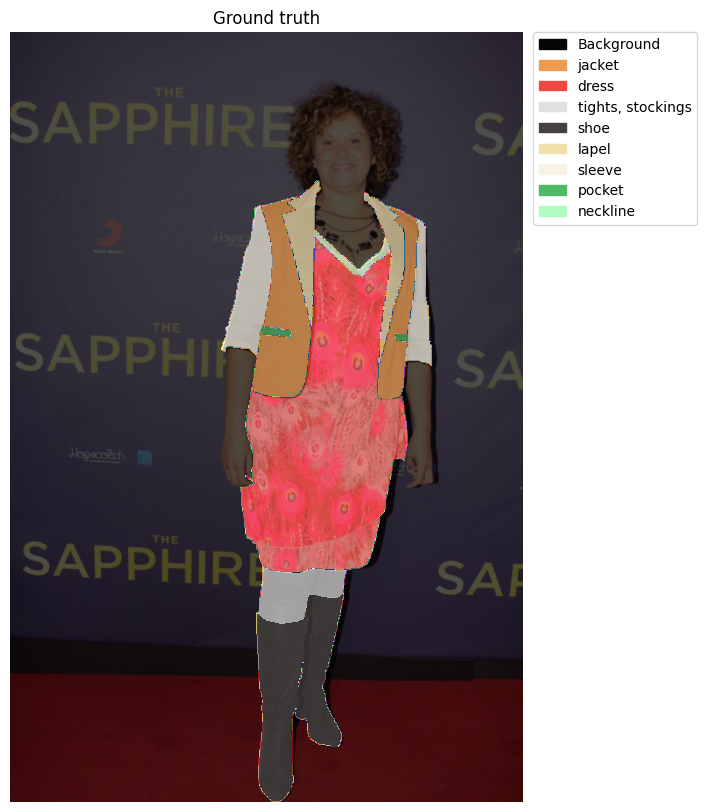

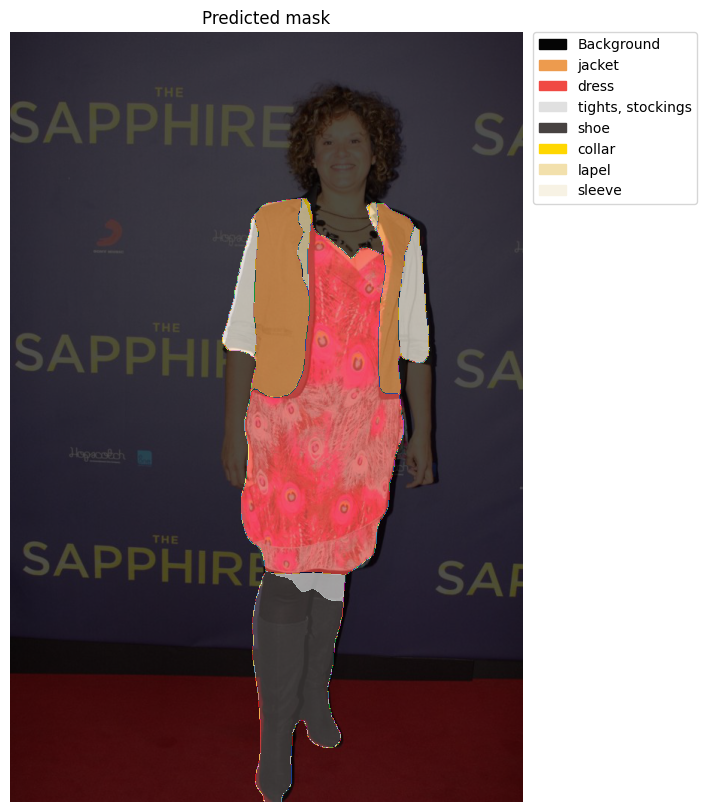

Predicted labels are: ['Background', 'jacket', 'dress', 'tights, stockings', 'shoe', 'collar', 'lapel', 'sleeve']
----------1f6b96f7f298903a77fa747ea4fe8840----------


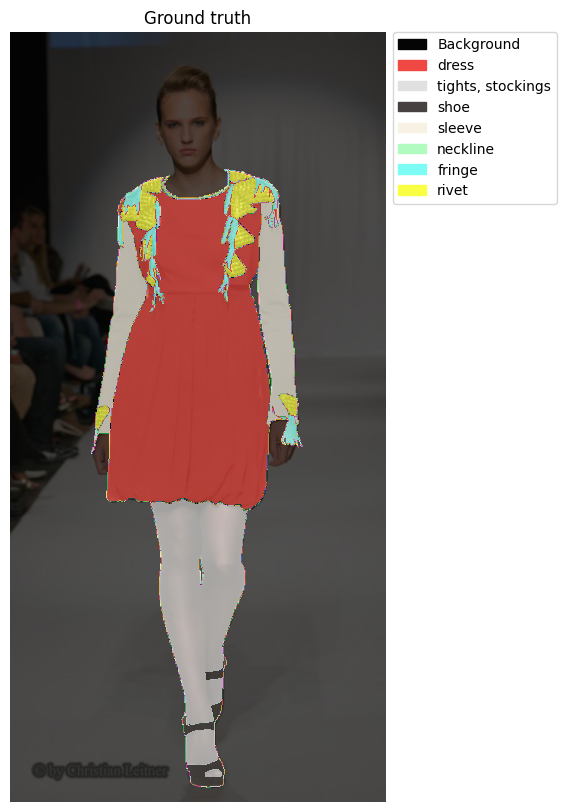

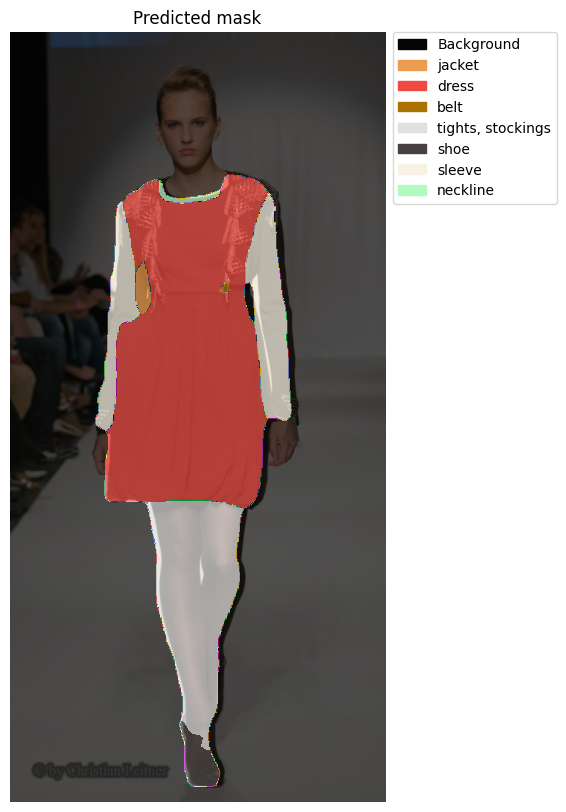

Predicted labels are: ['Background', 'jacket', 'dress', 'belt', 'tights, stockings', 'shoe', 'sleeve', 'neckline']


In [ ]:
ims = ['eb20c87403d09323d402b3461afbdb0e', '02182c58daf61dc5c5c64bb112b1f826','0349e23c22d9ab9a482ac3d38ec315d5','0420c7e0454fbbe11fadd23eb1f40d38','0483fc73ee89d2e8c4b63aeb3af0542c',
       'd7f4d06c3226febd8569d92476c19ef1','069223d02dcbfbe69af905daeb7fae26', '1f6b96f7f298903a77fa747ea4fe8840'
       ]

for im in ims:
  print('----------'+im+'----------')
  compare_segmentation('/content/val/'+ im +'.jpg', '/content/seg_val/'+ im +'_seg.png')

#### Pants:

----------08680e1257c83a5a603ae3ef67ef3dde----------


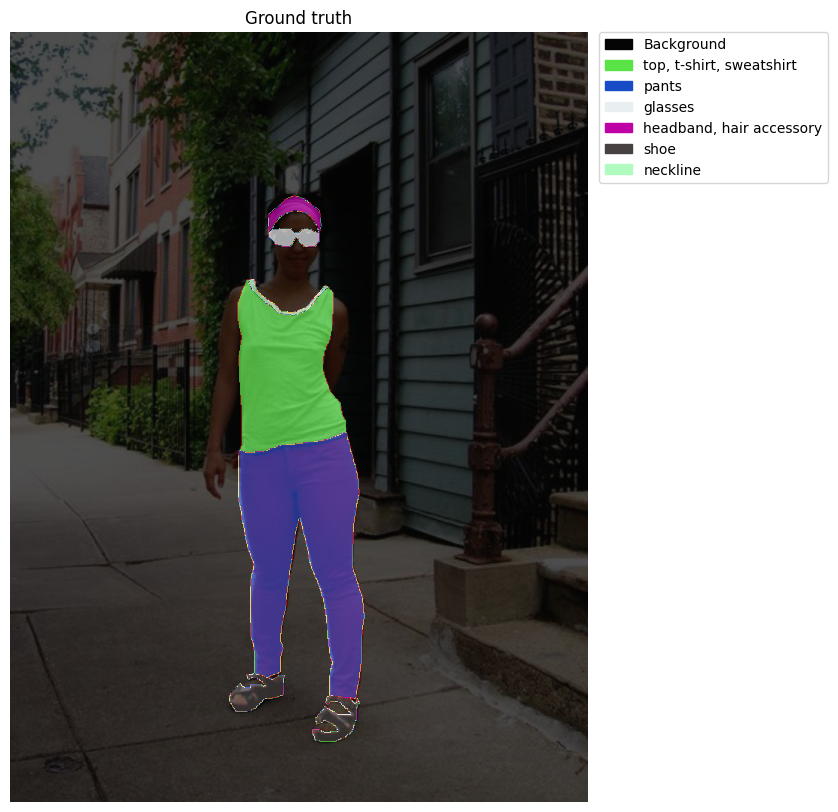

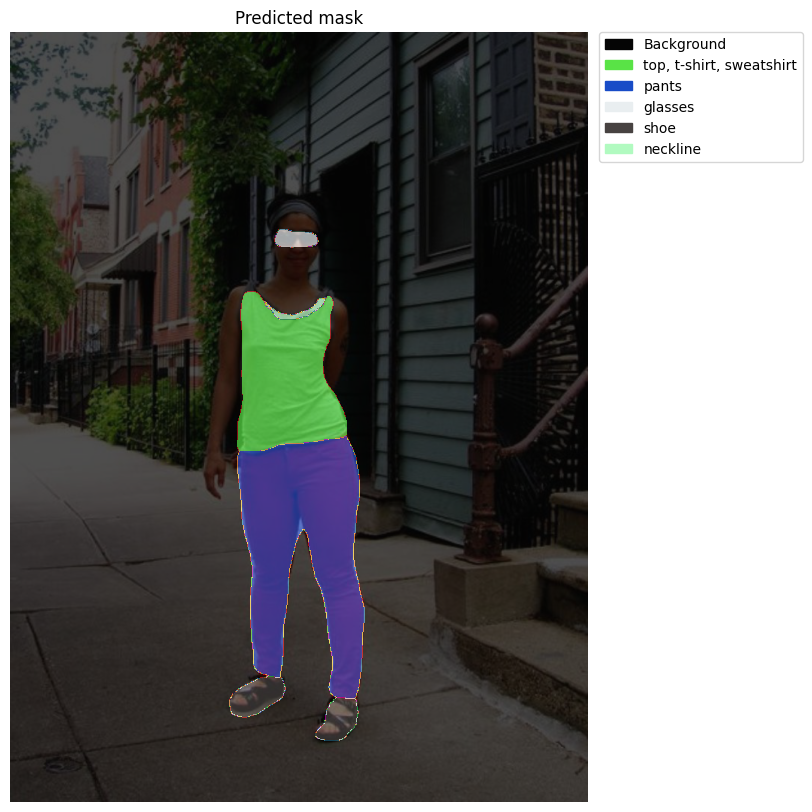

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'pants', 'glasses', 'shoe', 'neckline']
----------02916664cd606bb5486353f200a475a3----------


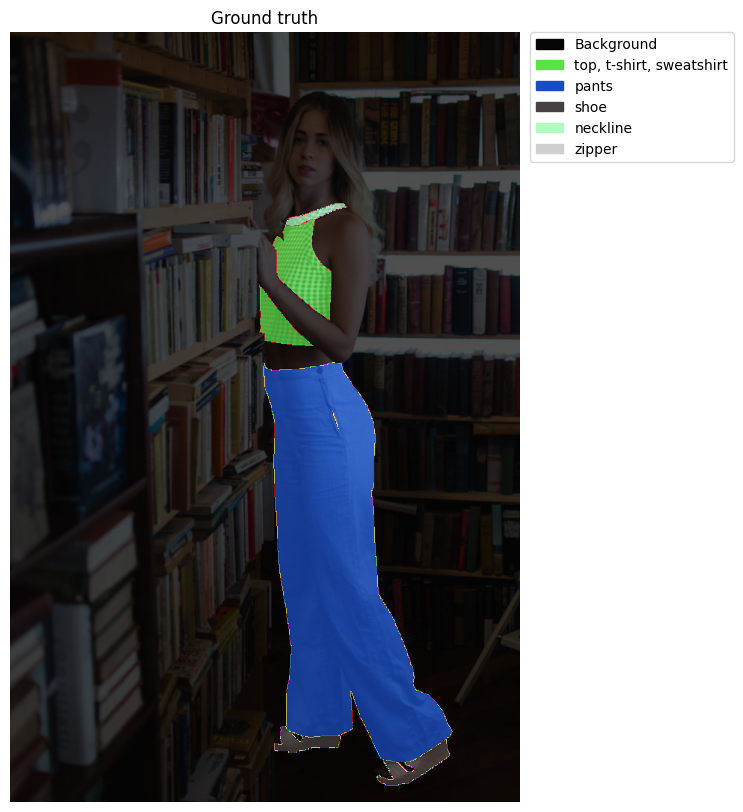

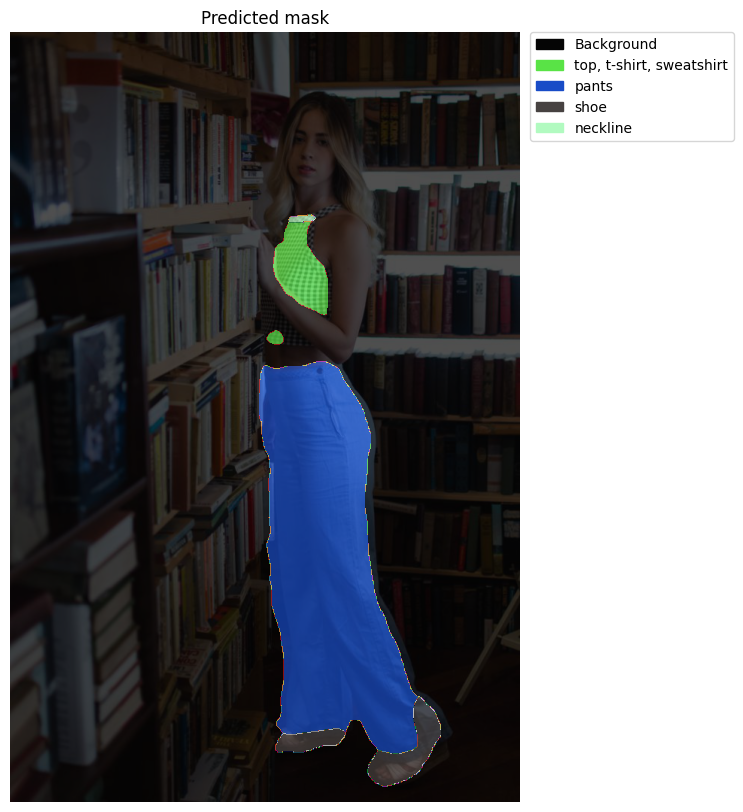

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'pants', 'shoe', 'neckline']
----------05df29d770955d6fe8d7873982aba082----------


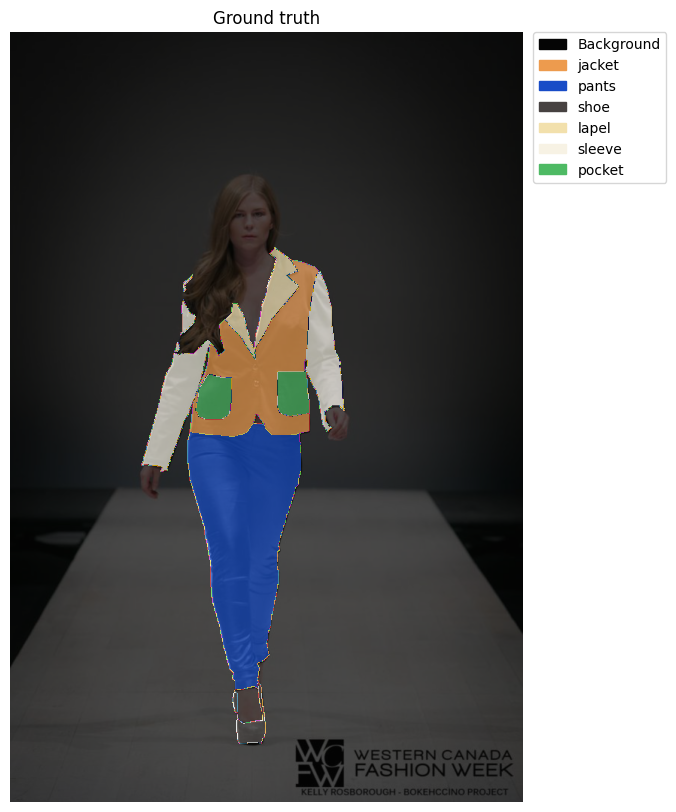

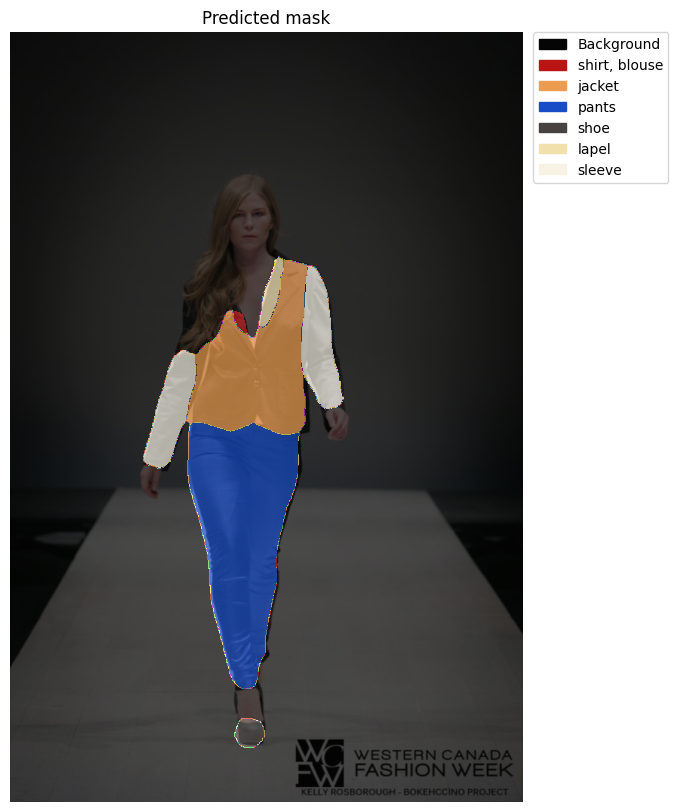

Predicted labels are: ['Background', 'shirt, blouse', 'jacket', 'pants', 'shoe', 'lapel', 'sleeve']
----------0a45b6b033bf0077a15f484e98f3dbfe----------


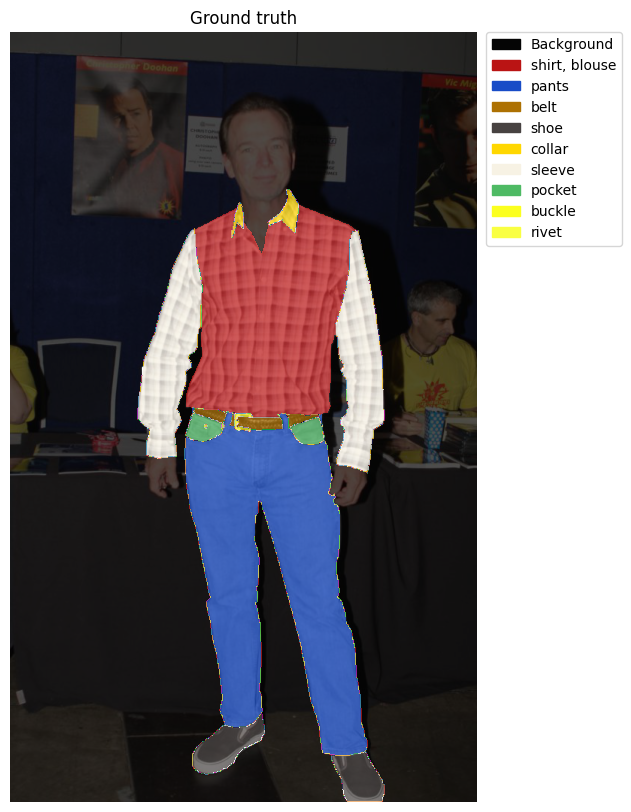

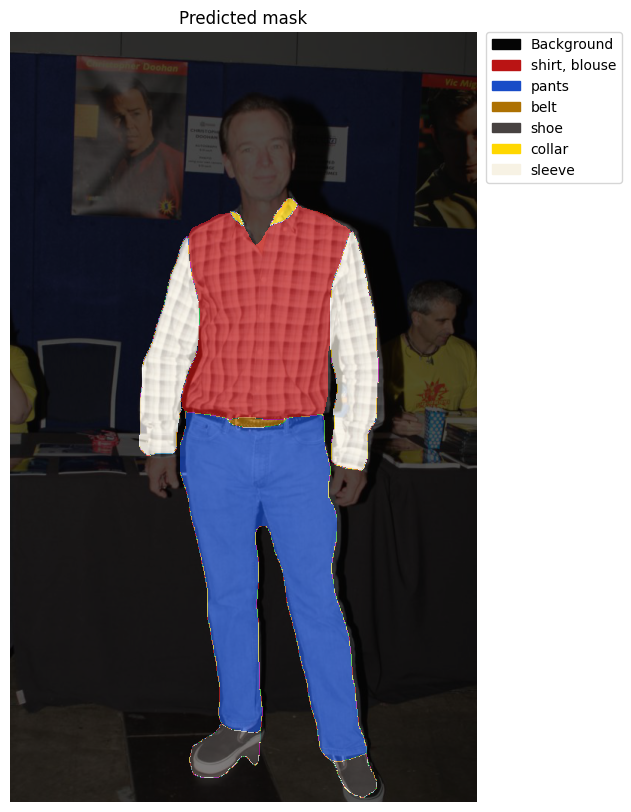

Predicted labels are: ['Background', 'shirt, blouse', 'pants', 'belt', 'shoe', 'collar', 'sleeve']


In [ ]:
ims = ['08680e1257c83a5a603ae3ef67ef3dde','02916664cd606bb5486353f200a475a3','05df29d770955d6fe8d7873982aba082','0a45b6b033bf0077a15f484e98f3dbfe']

for im in ims:
  print('----------'+im+'----------')
  compare_segmentation('/content/val/'+ im +'.jpg', '/content/seg_val/'+ im +'_seg.png')

#### Shorts:

----------0d5d5e00e589fe5641b919179794994b----------


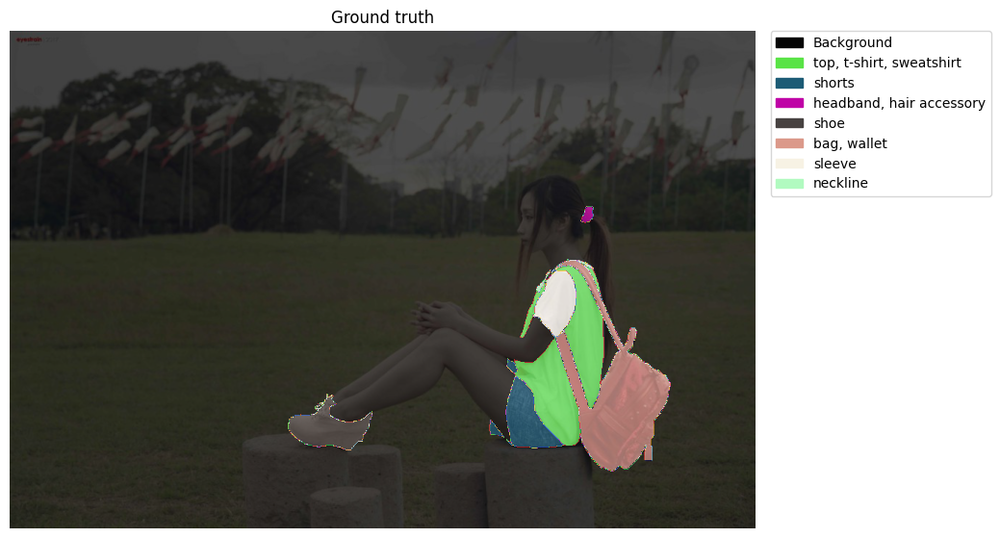

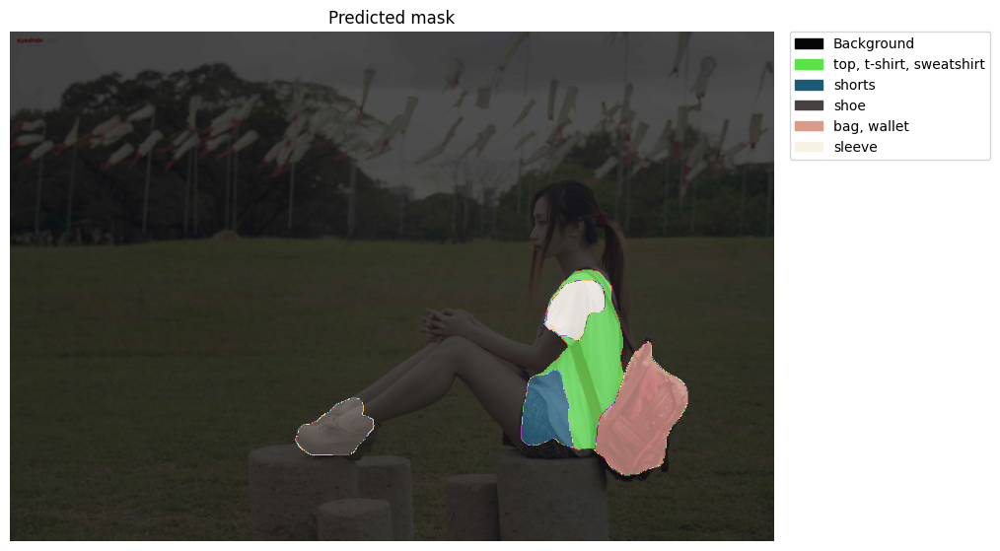

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'shorts', 'shoe', 'bag, wallet', 'sleeve']
----------f2cf1eff03298dcaf840385c787165f8----------


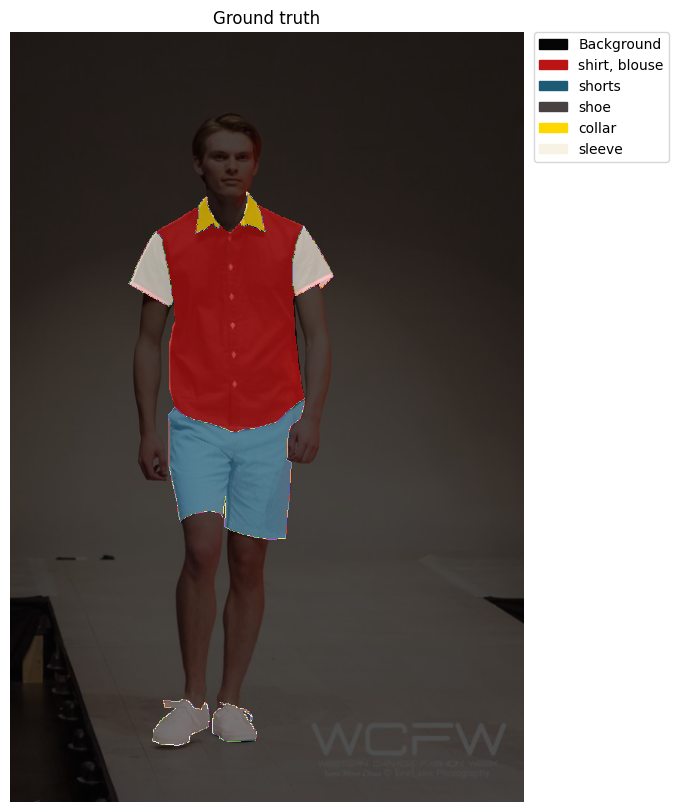

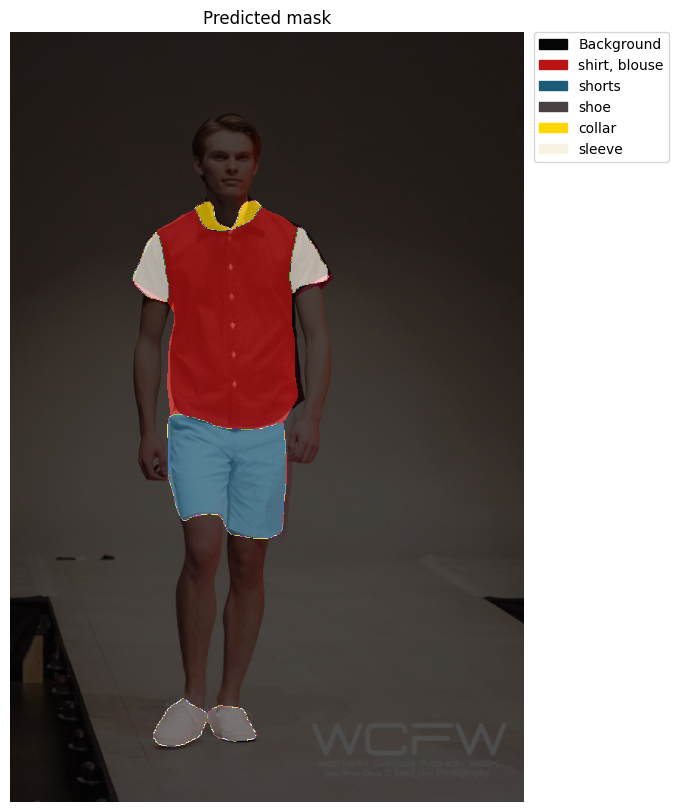

Predicted labels are: ['Background', 'shirt, blouse', 'shorts', 'shoe', 'collar', 'sleeve']
----------0e5ecf98835cbd0dddd1b45c788005c3----------


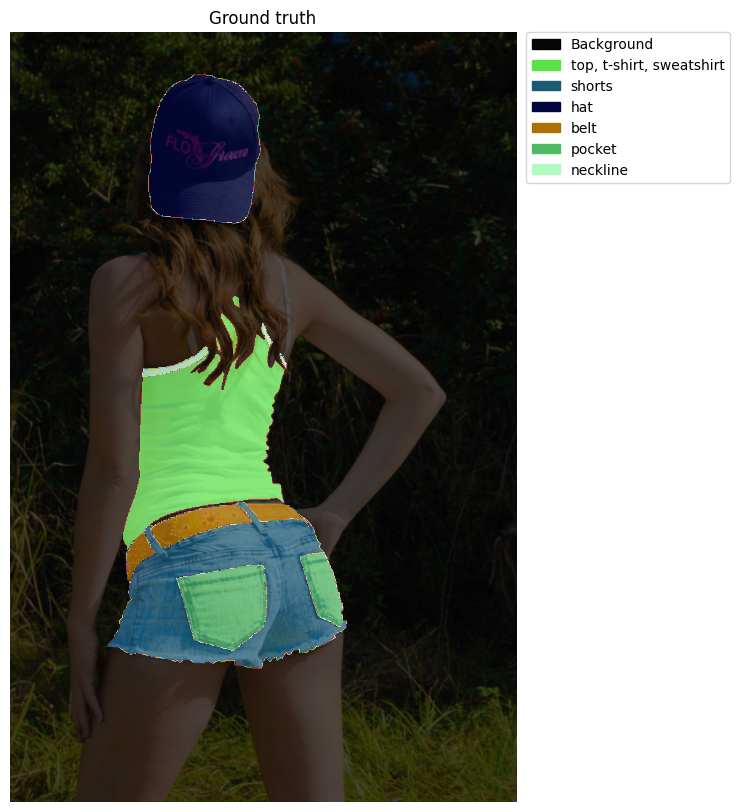

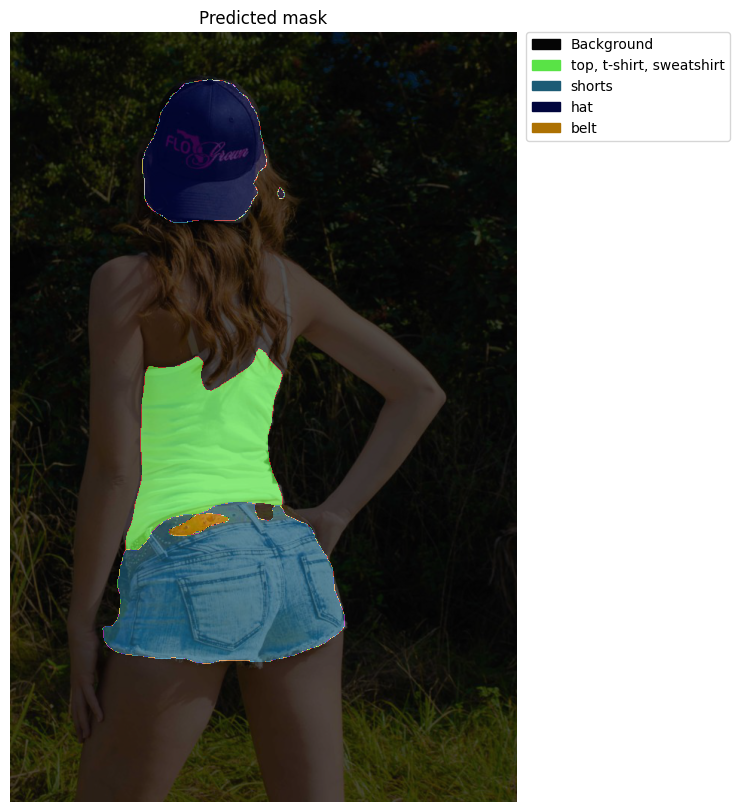

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'shorts', 'hat', 'belt']
----------176c976ed8edcf21eebef9de662adc18----------


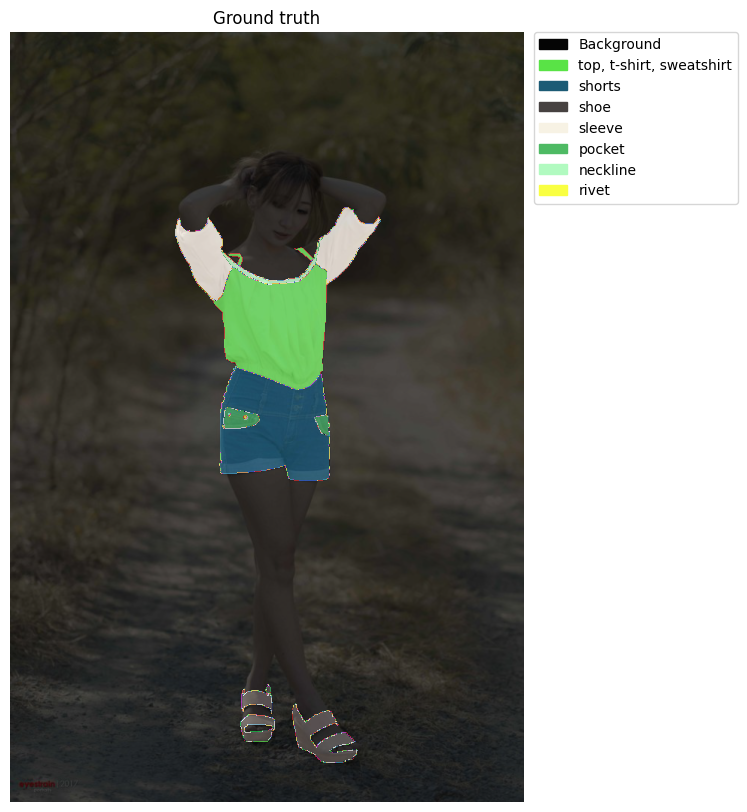

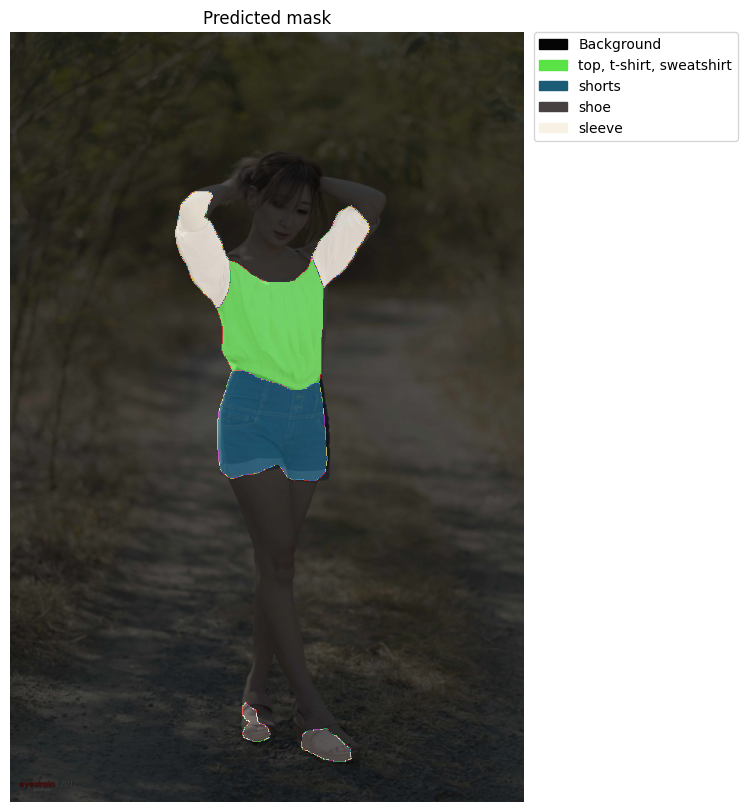

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'shorts', 'shoe', 'sleeve']
----------3b0e3da1465e802b7855e4c532638e7e----------


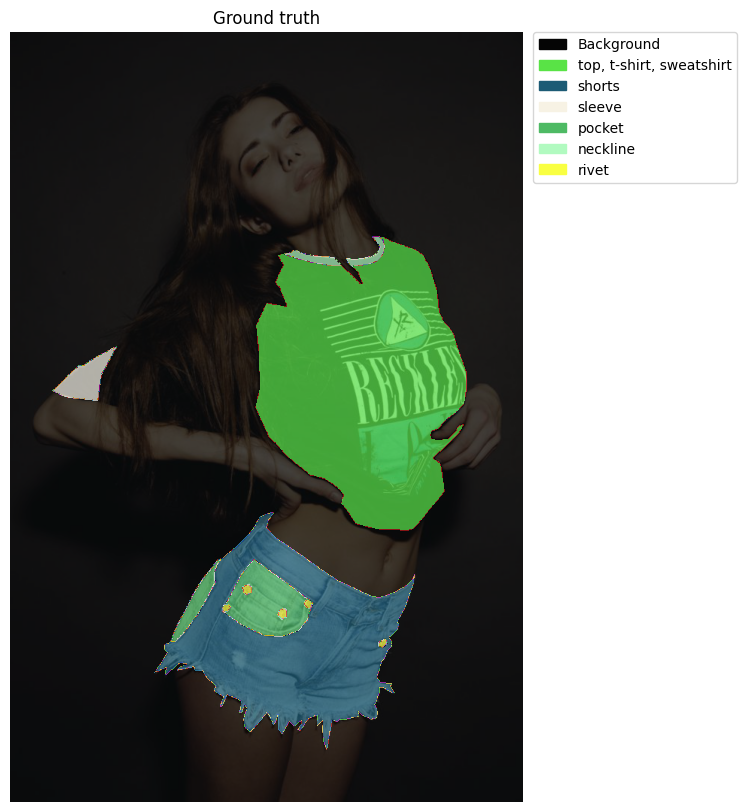

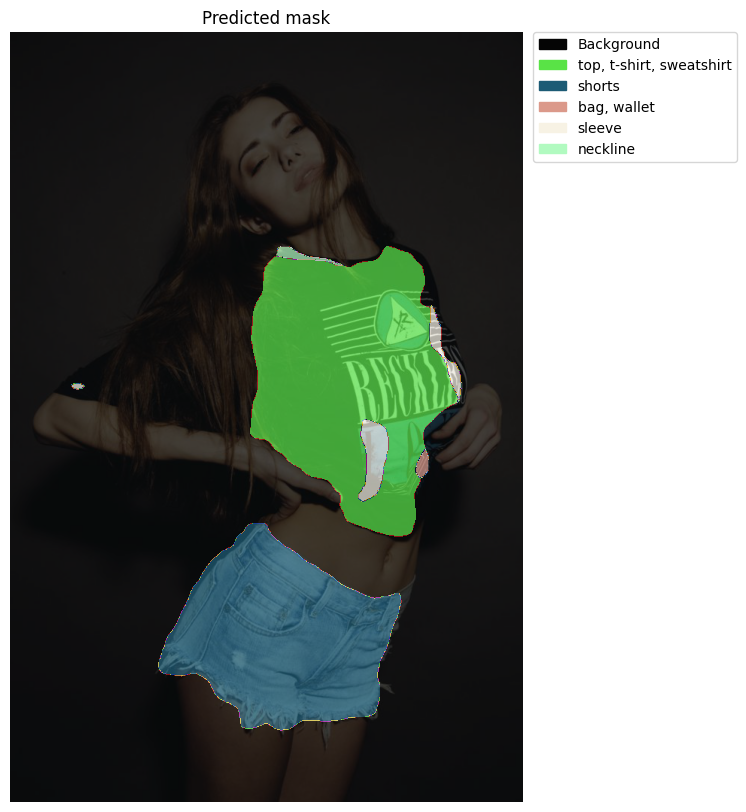

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'shorts', 'bag, wallet', 'sleeve', 'neckline']
----------3dda4e48dc4aaf7cb08016c5ae77a8fb----------


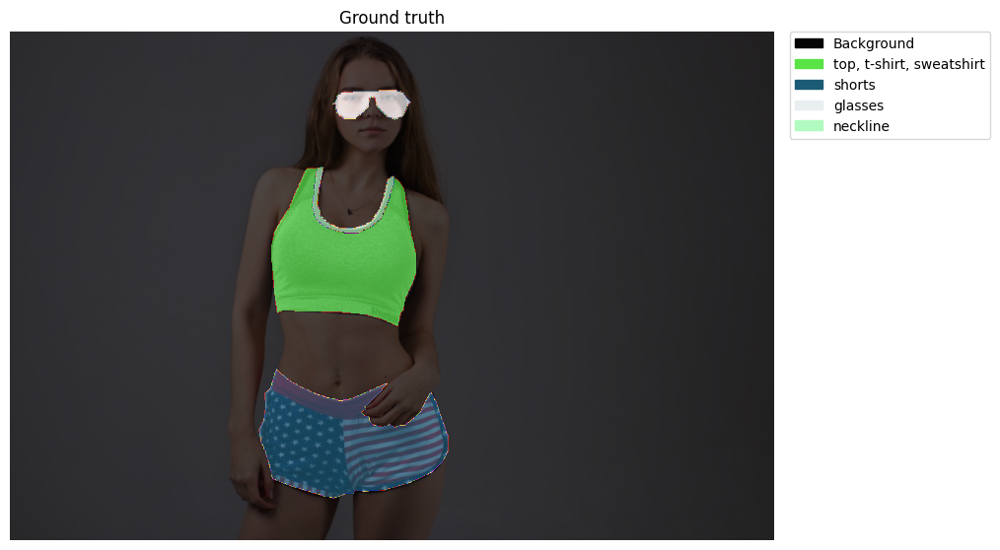

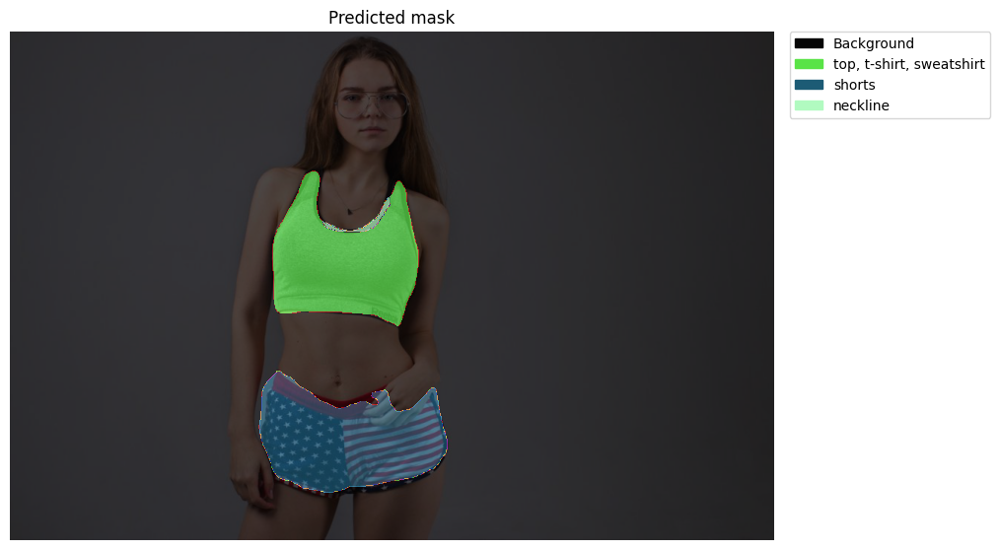

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'shorts', 'neckline']
----------65aba1fc79c8b44c66e8f75be8b7633e----------


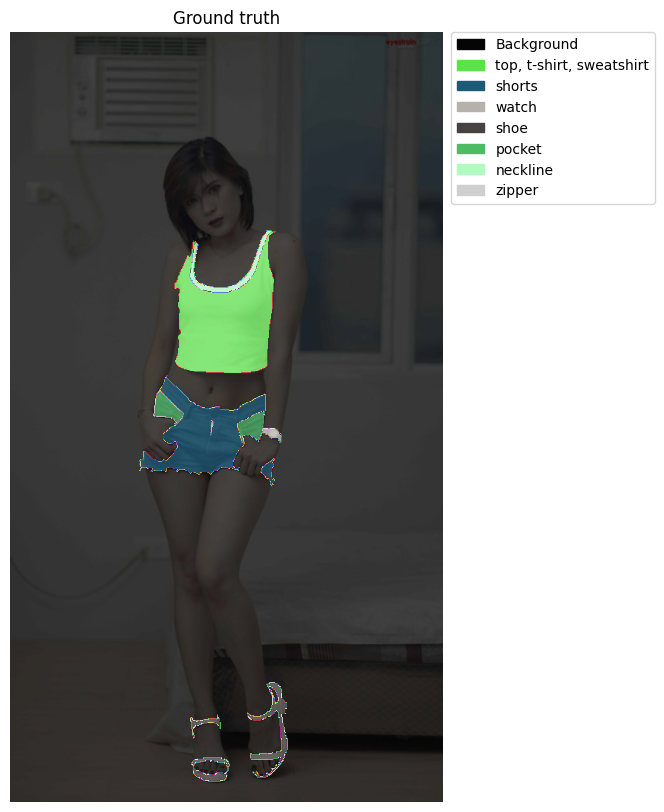

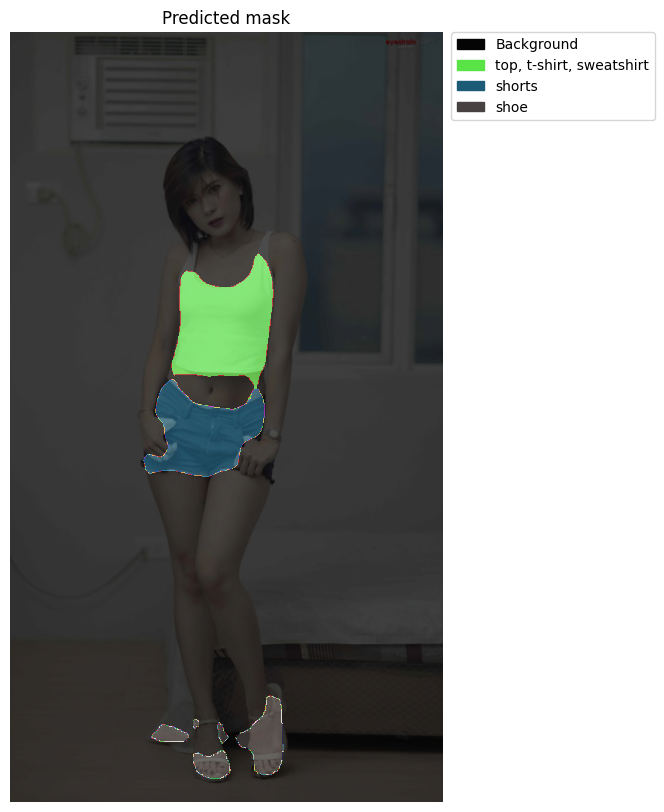

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'shorts', 'shoe']
----------775c380cd79c0f3a3e34a41f89468022----------


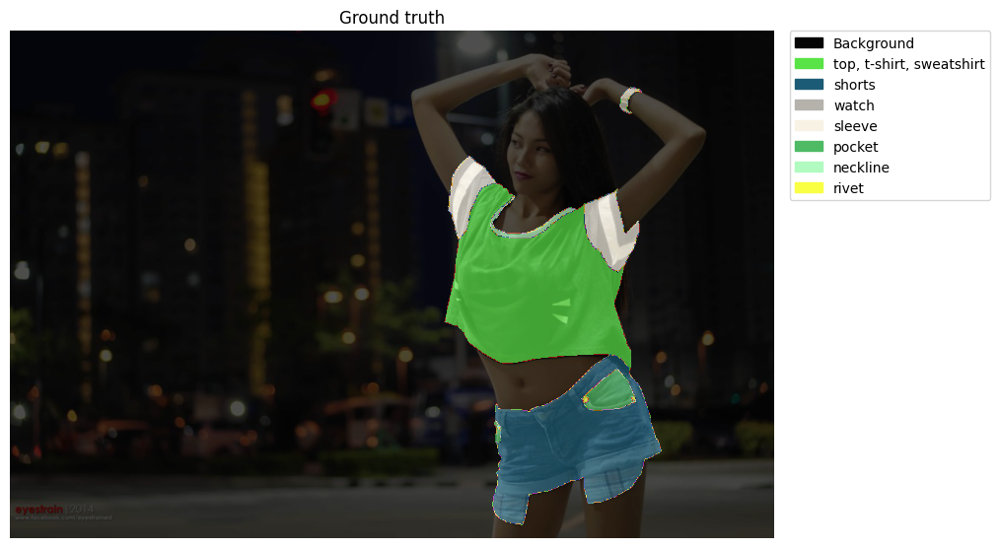

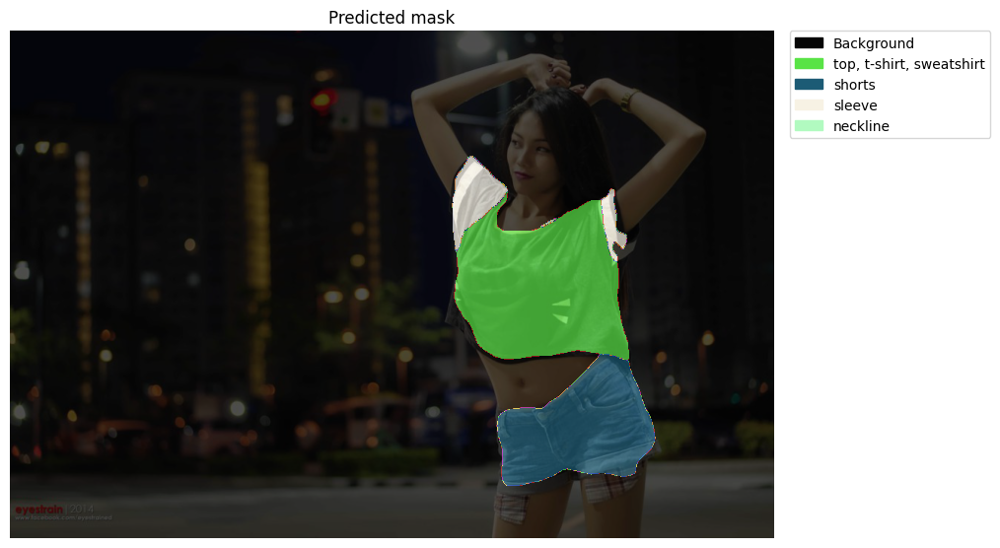

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'shorts', 'sleeve', 'neckline']
----------941fb0eae1c264c3b18aa7161929a4d8----------


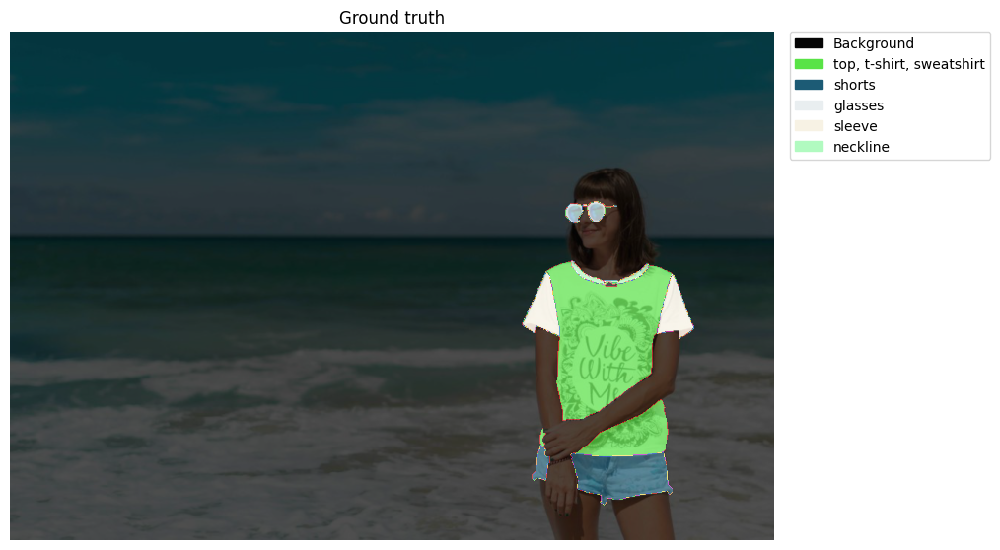

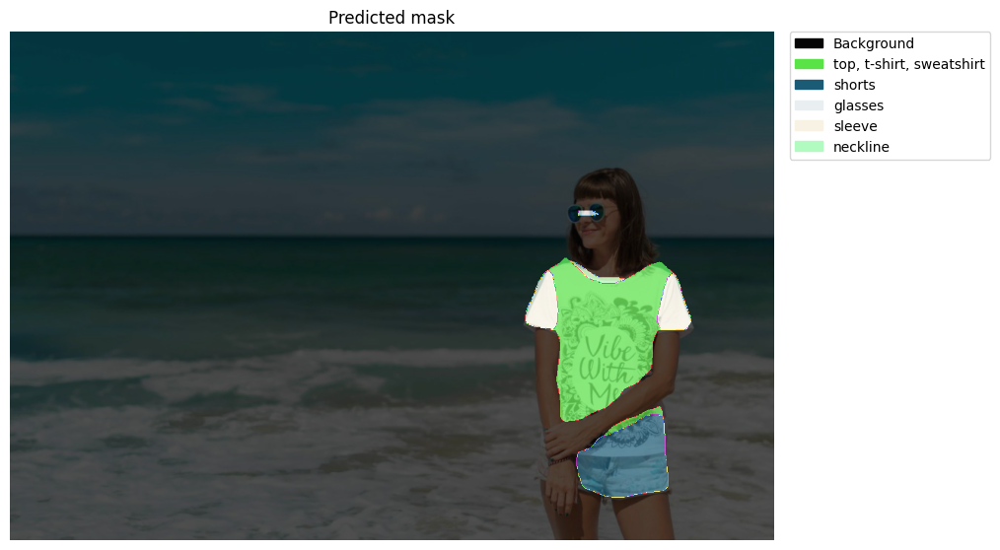

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'shorts', 'glasses', 'sleeve', 'neckline']
----------9c2944165b3d4390a3aa62dc0a07fe7e----------


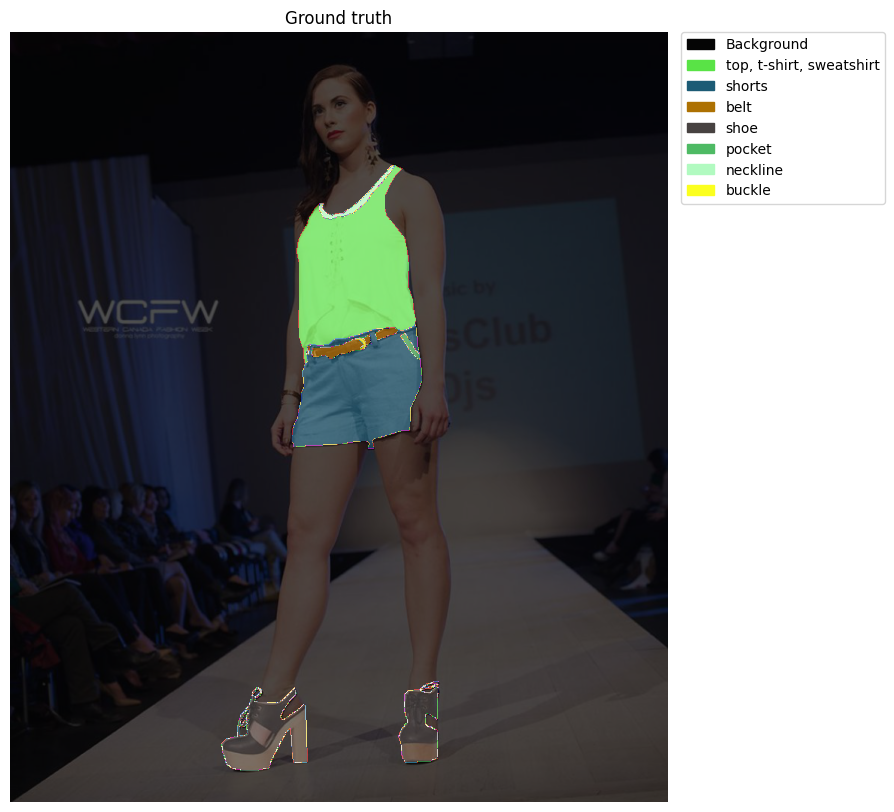

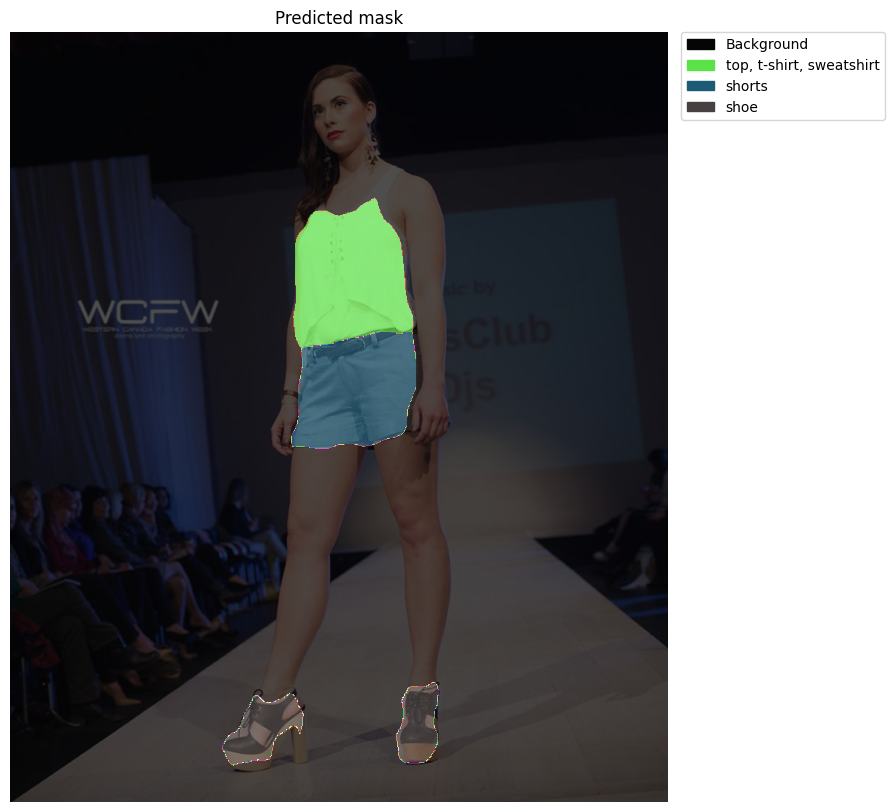

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'shorts', 'shoe']
----------a8769fb3b98cdcf3cfaef9dcd329a8d1----------


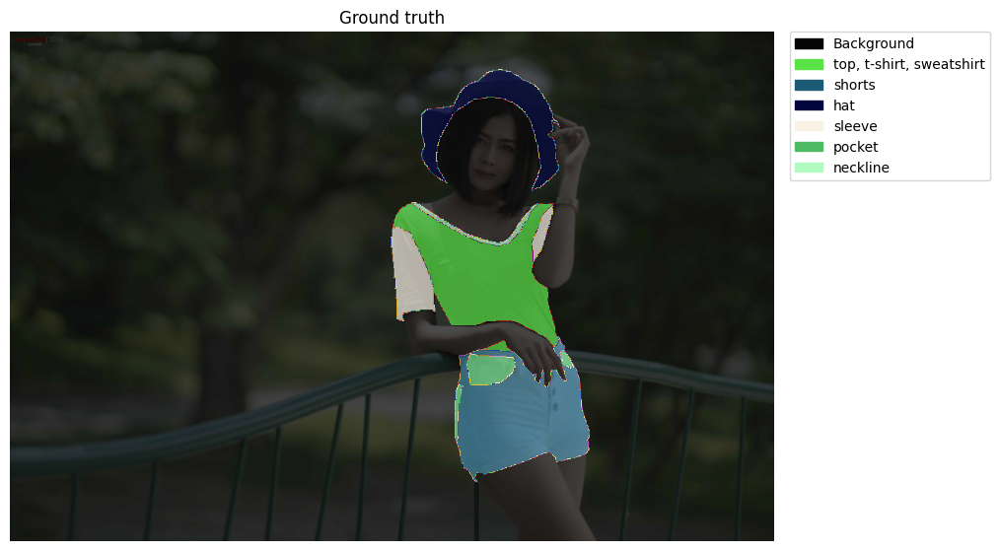

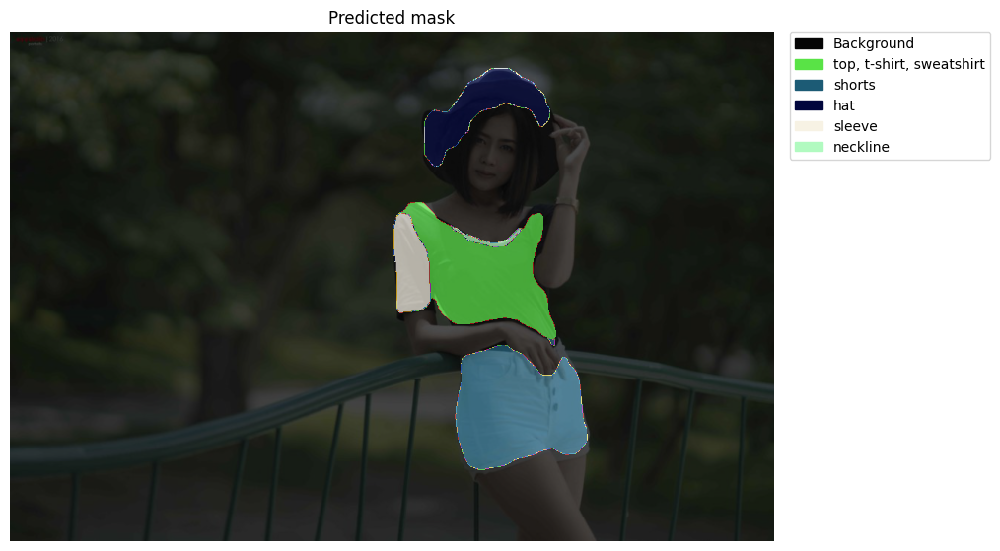

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'shorts', 'hat', 'sleeve', 'neckline']


In [ ]:
ims = ['0d5d5e00e589fe5641b919179794994b','f2cf1eff03298dcaf840385c787165f8','0e5ecf98835cbd0dddd1b45c788005c3','176c976ed8edcf21eebef9de662adc18','3b0e3da1465e802b7855e4c532638e7e', 
       '3dda4e48dc4aaf7cb08016c5ae77a8fb', '65aba1fc79c8b44c66e8f75be8b7633e', '775c380cd79c0f3a3e34a41f89468022', '941fb0eae1c264c3b18aa7161929a4d8', '9c2944165b3d4390a3aa62dc0a07fe7e',
       'a8769fb3b98cdcf3cfaef9dcd329a8d1'
       ]

for im in ims:
  print('----------'+im+'----------')
  compare_segmentation('/content/val/'+ im +'.jpg', '/content/seg_val/'+ im +'_seg.png')

#### Skirt:

----------f19900e56c52d4736c9ddf371d9181cc----------


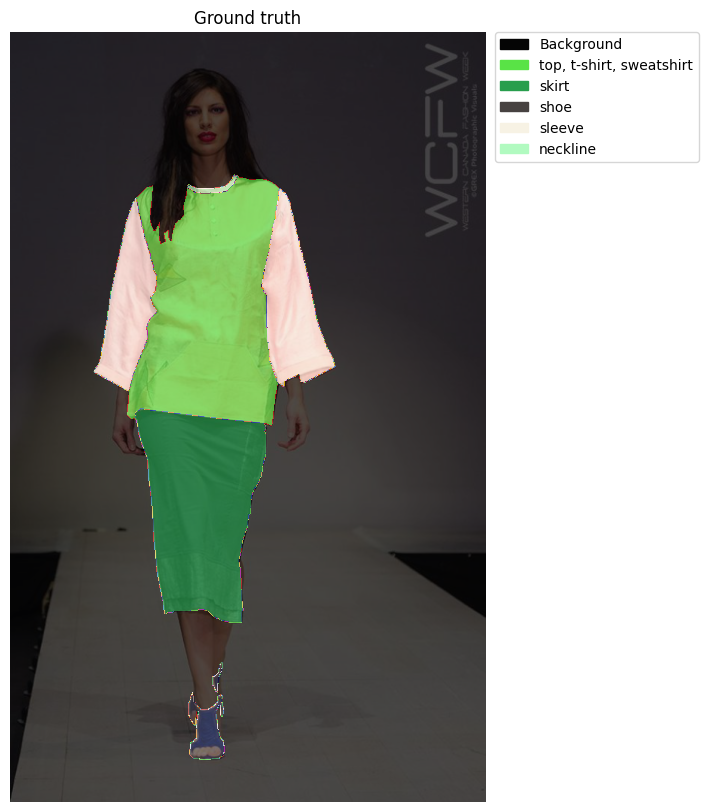

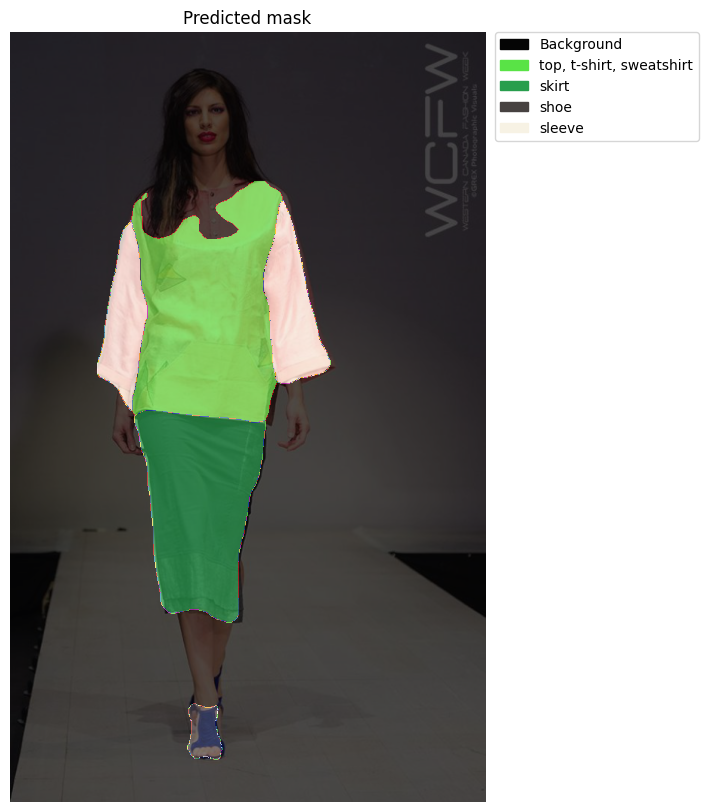

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'skirt', 'shoe', 'sleeve']
----------f64abd043fc1cbeda3ef97b762a4092f----------


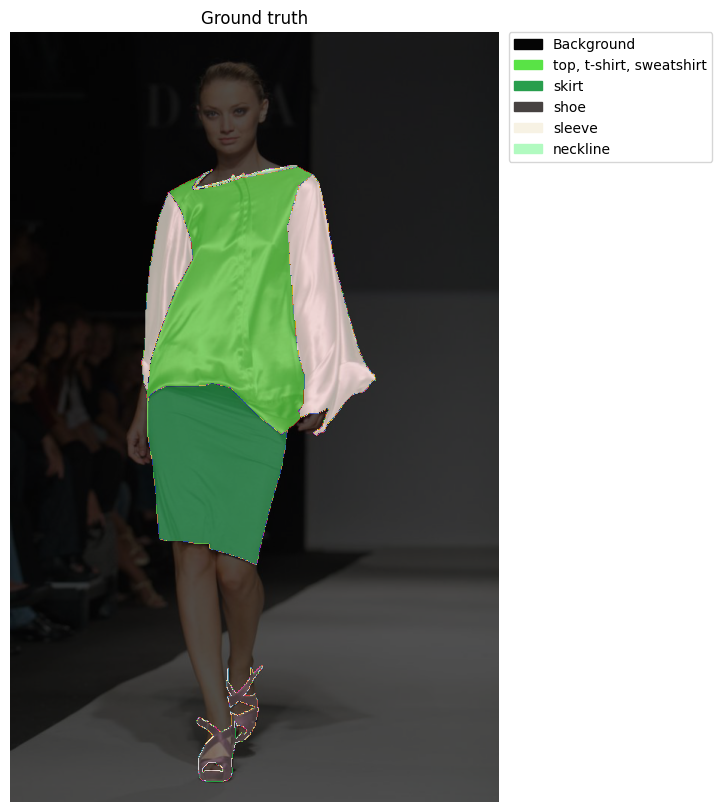

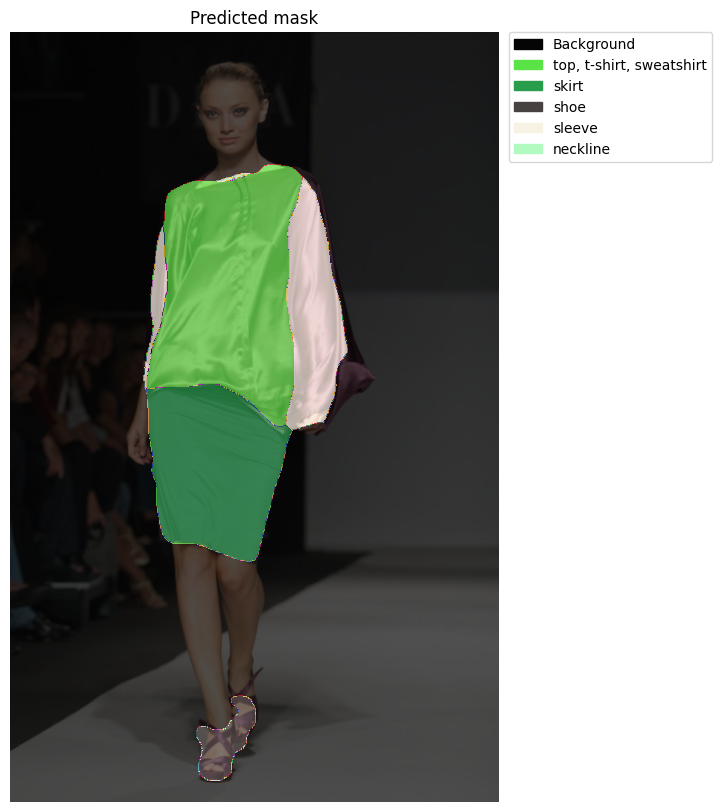

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'skirt', 'shoe', 'sleeve', 'neckline']
----------f6890fd9ddbb8cf2d17a332eb72e0ea2----------


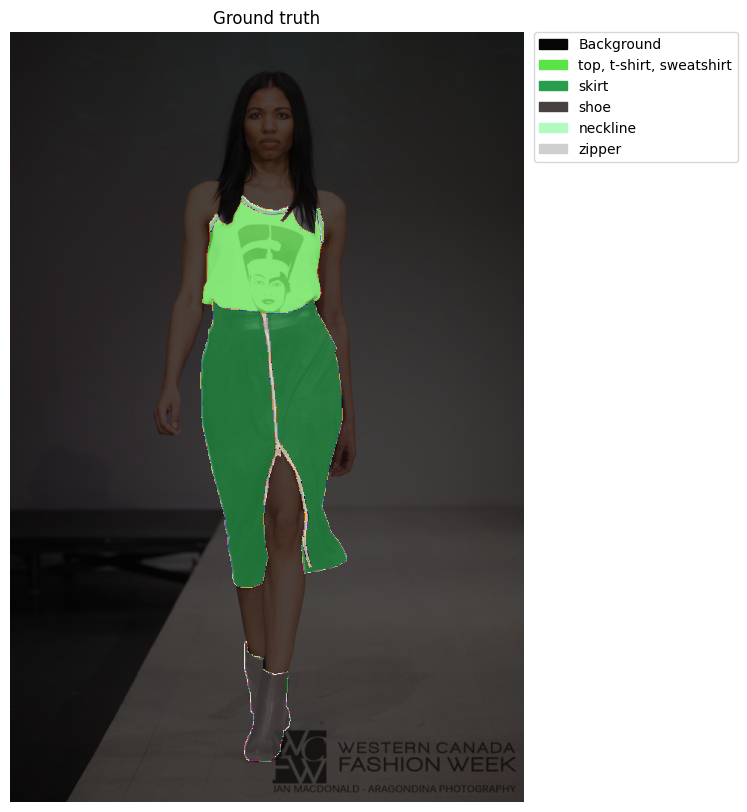

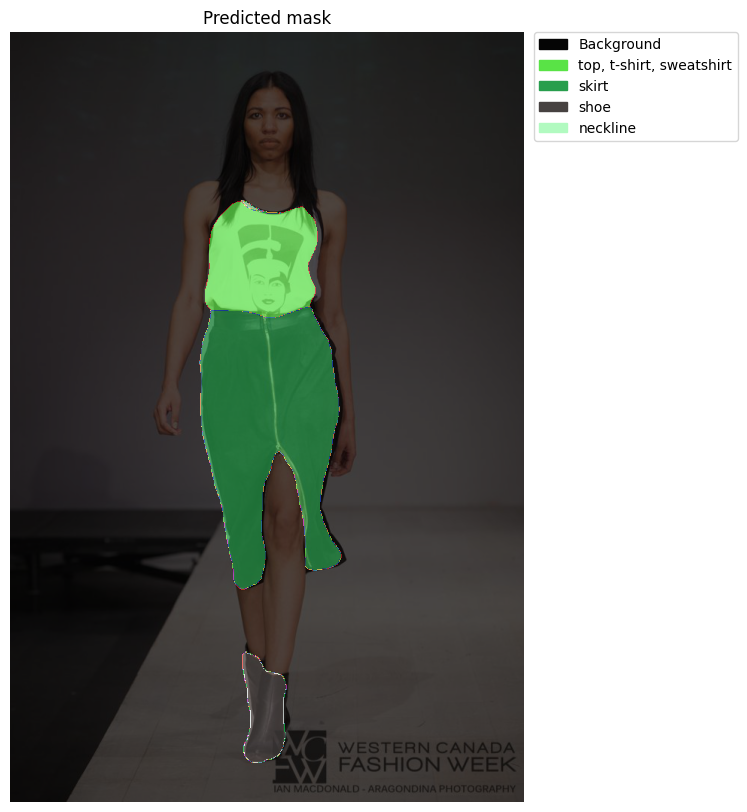

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'skirt', 'shoe', 'neckline']
----------fd5e95a00bcee9d241c1bca1bf4c16c0----------


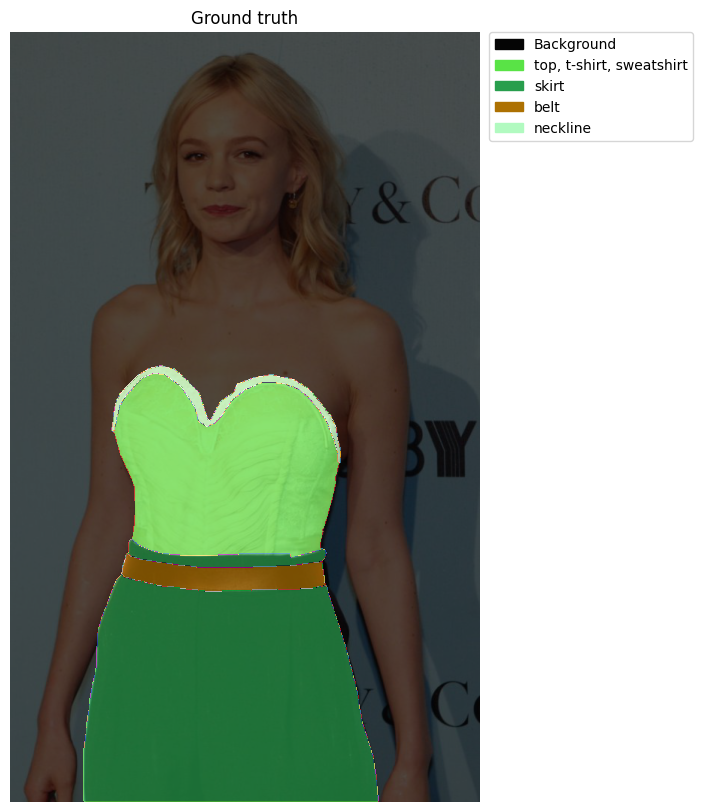

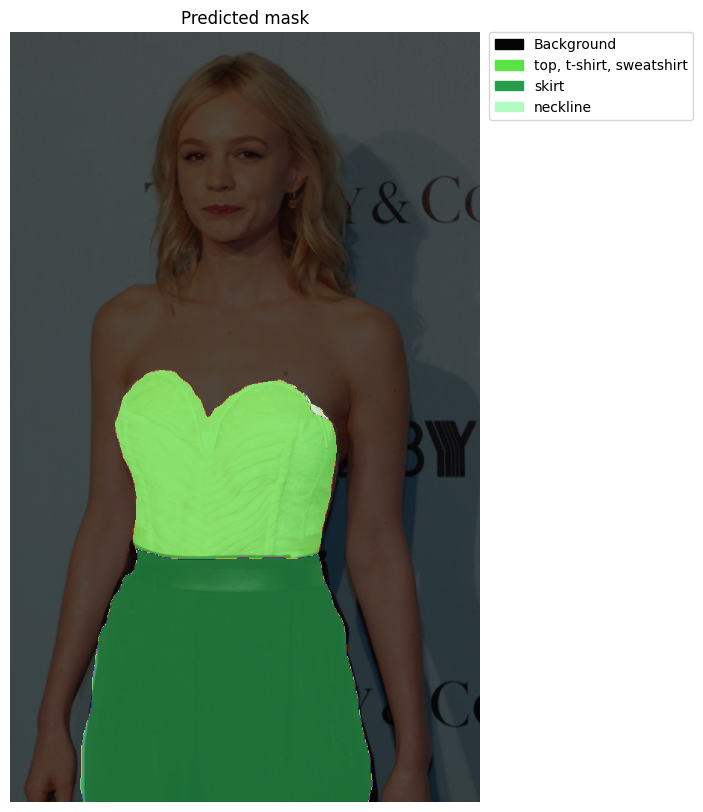

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'skirt', 'neckline']
----------26a82d34b44654c6812863ecacb3f3fc----------


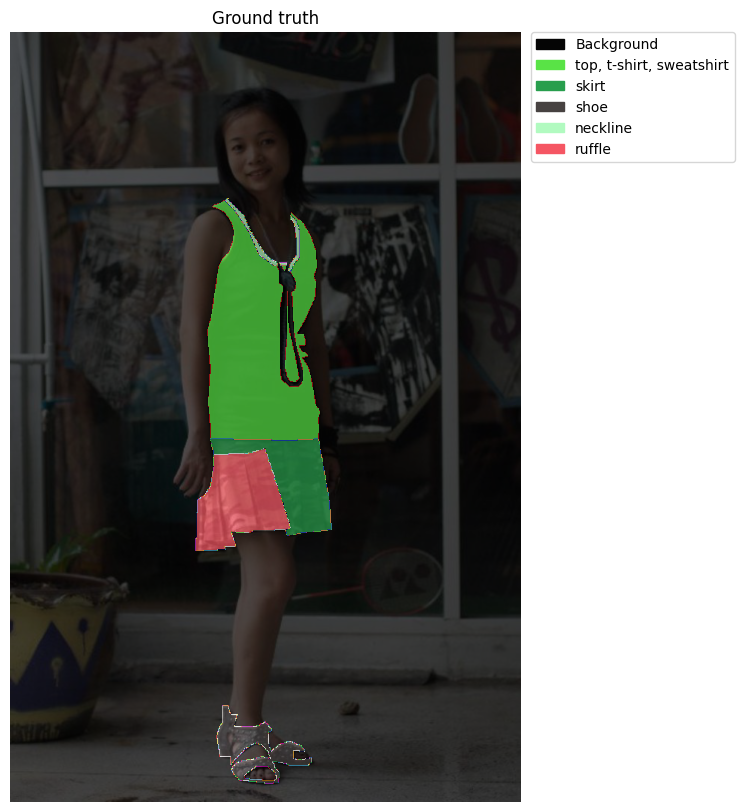

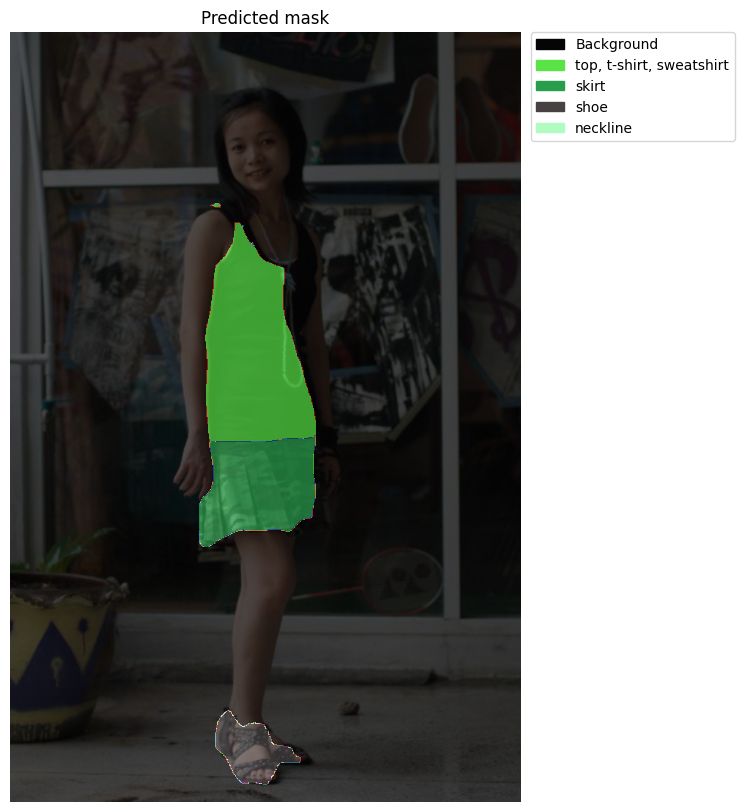

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'skirt', 'shoe', 'neckline']
----------3109762baa95cfc50b5a454db19d4143----------


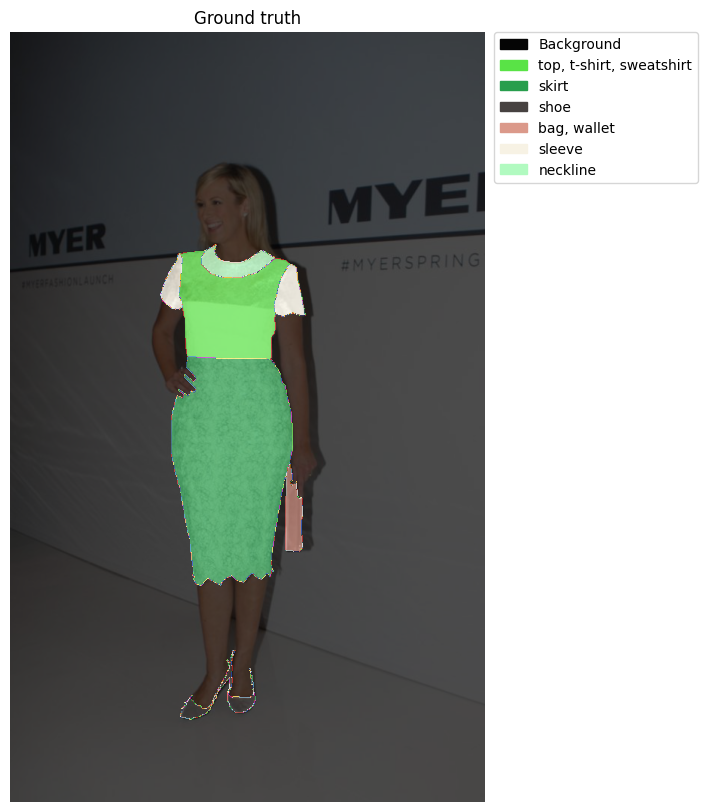

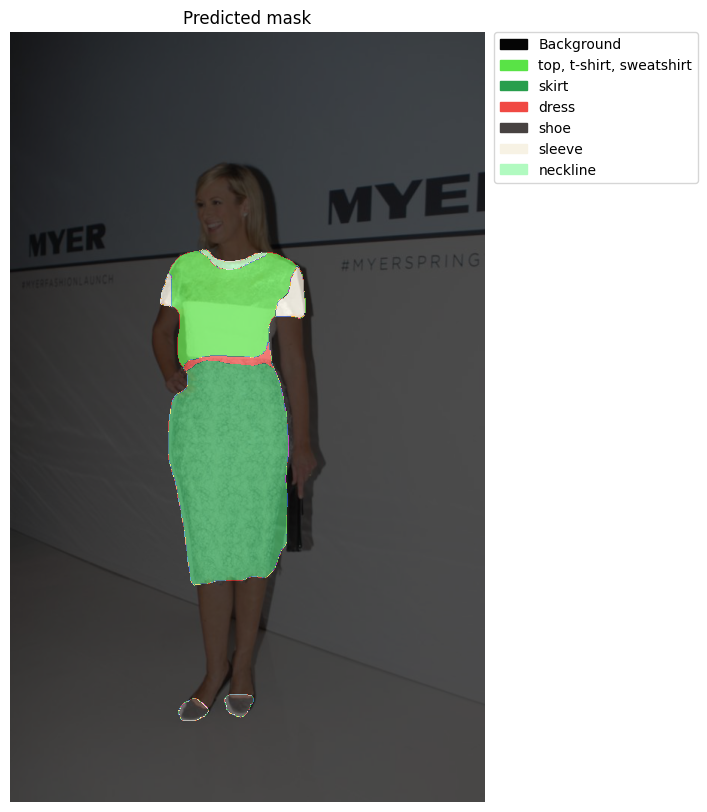

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'skirt', 'dress', 'shoe', 'sleeve', 'neckline']
----------473ca12a9a40ada656994abef67bf900----------


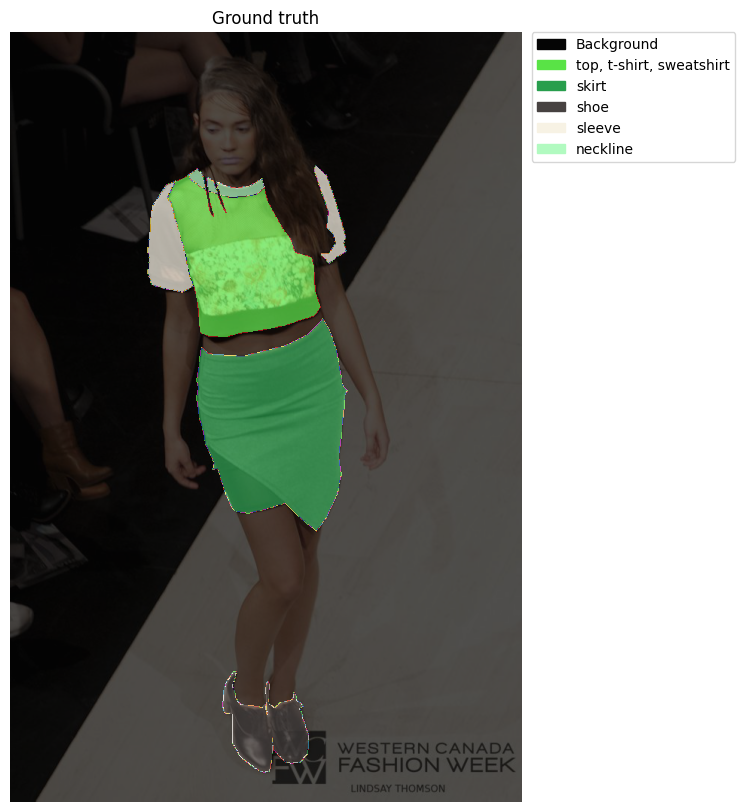

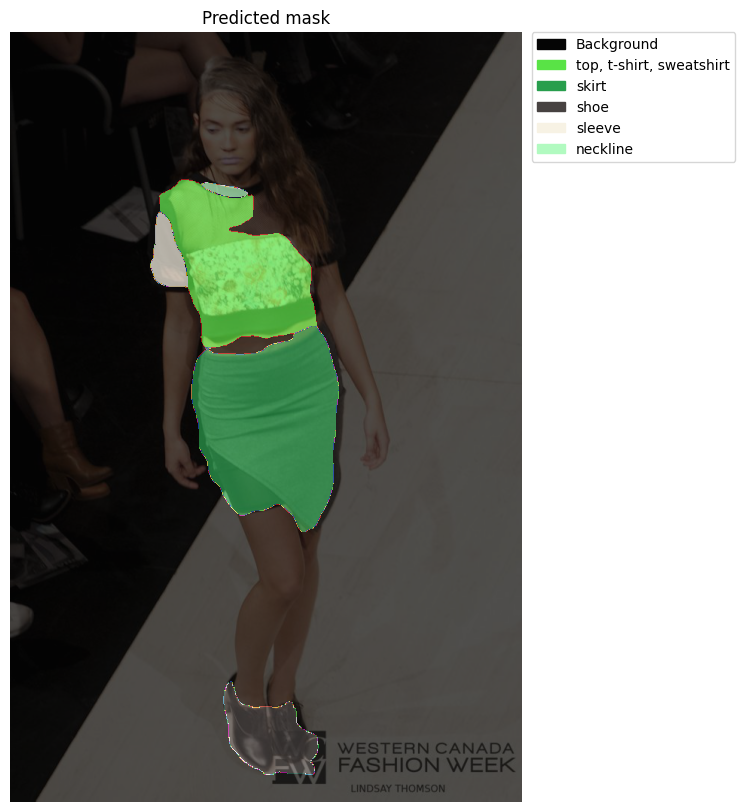

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'skirt', 'shoe', 'sleeve', 'neckline']
----------4cea97e3bd3c0e426073cf4fe482b9ad----------


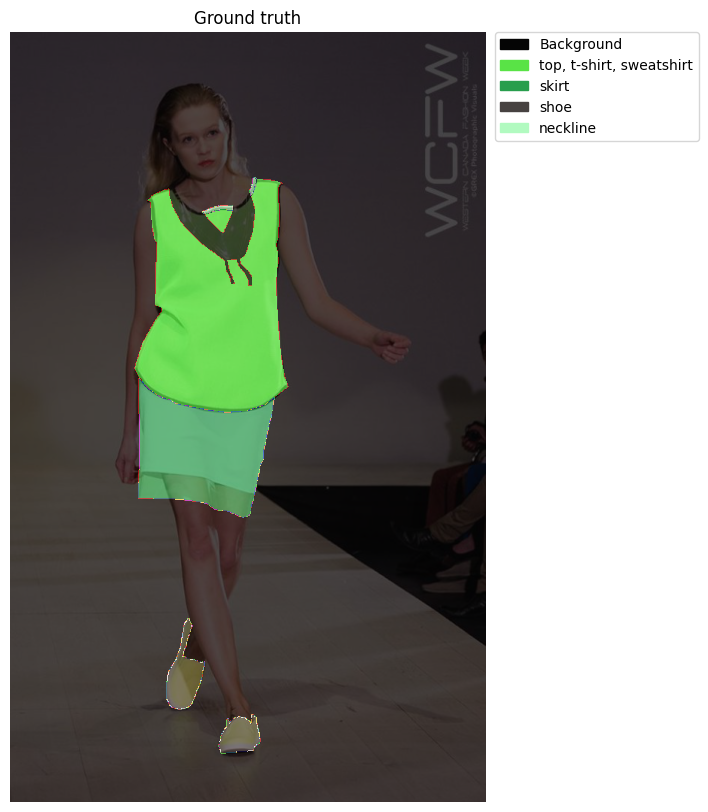

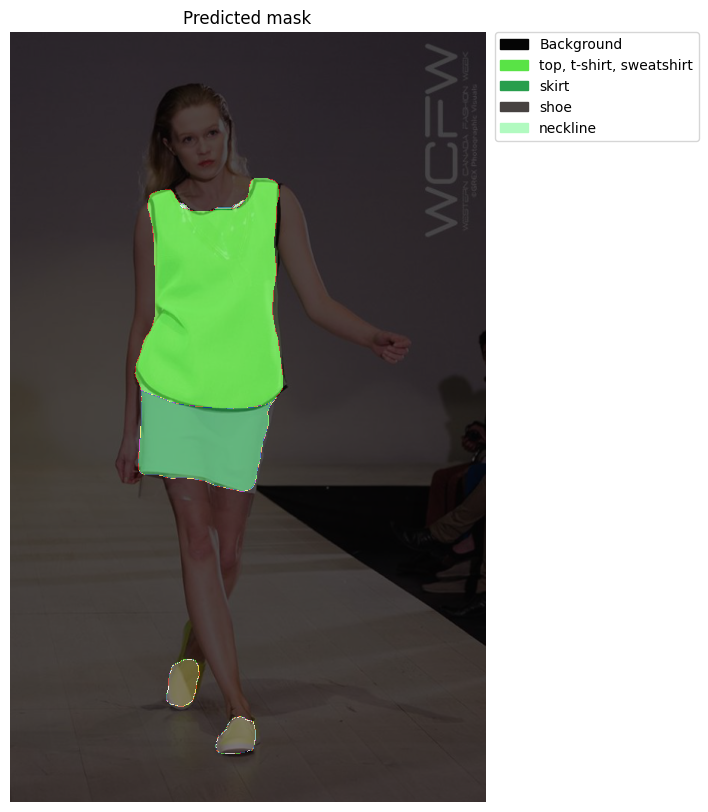

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'skirt', 'shoe', 'neckline']


In [ ]:
ims = ['f19900e56c52d4736c9ddf371d9181cc', 'f64abd043fc1cbeda3ef97b762a4092f', 'f6890fd9ddbb8cf2d17a332eb72e0ea2', 'fd5e95a00bcee9d241c1bca1bf4c16c0',
       '26a82d34b44654c6812863ecacb3f3fc', '3109762baa95cfc50b5a454db19d4143', '473ca12a9a40ada656994abef67bf900', '4cea97e3bd3c0e426073cf4fe482b9ad'
       ]

for im in ims:
  print('----------'+im+'----------')
  compare_segmentation('/content/val/'+ im +'.jpg', '/content/seg_val/'+ im +'_seg.png')

#### Umbrella:

----------f6d5d138127a985997df20d4cad1b276----------


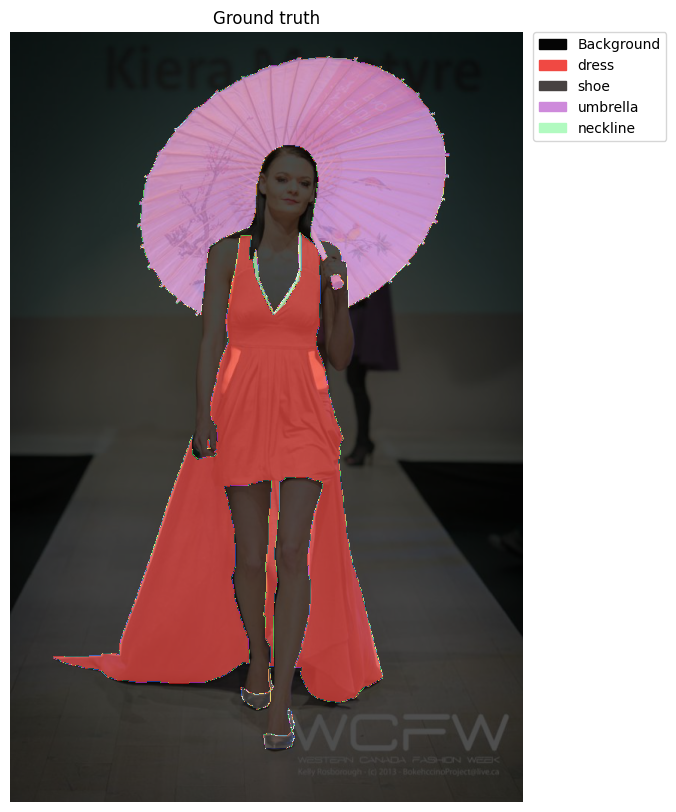

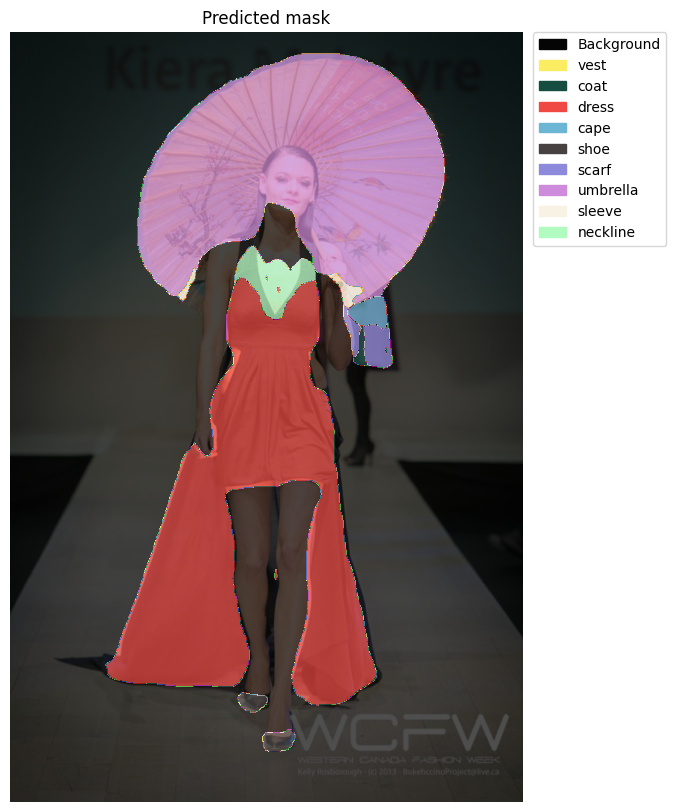

Predicted labels are: ['Background', 'vest', 'coat', 'dress', 'cape', 'shoe', 'scarf', 'umbrella', 'sleeve', 'neckline']


In [ ]:
ims = ['f6d5d138127a985997df20d4cad1b276']

for im in ims:
  print('----------'+im+'----------')
  compare_segmentation('/content/val/'+ im +'.jpg', '/content/seg_val/'+ im +'_seg.png')

### Interclass confusion

----------efd0bee7ed5502dcf4e482ddd63c7042----------


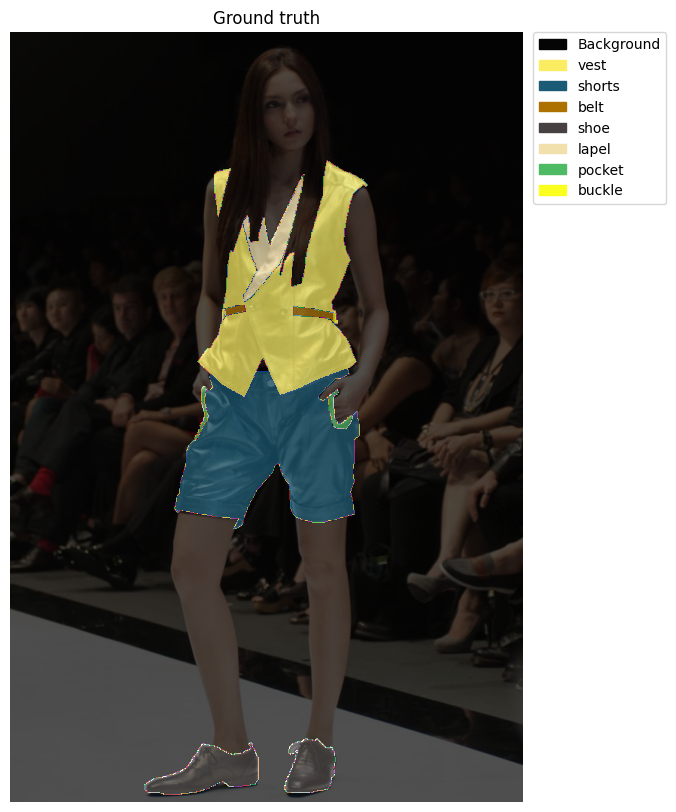

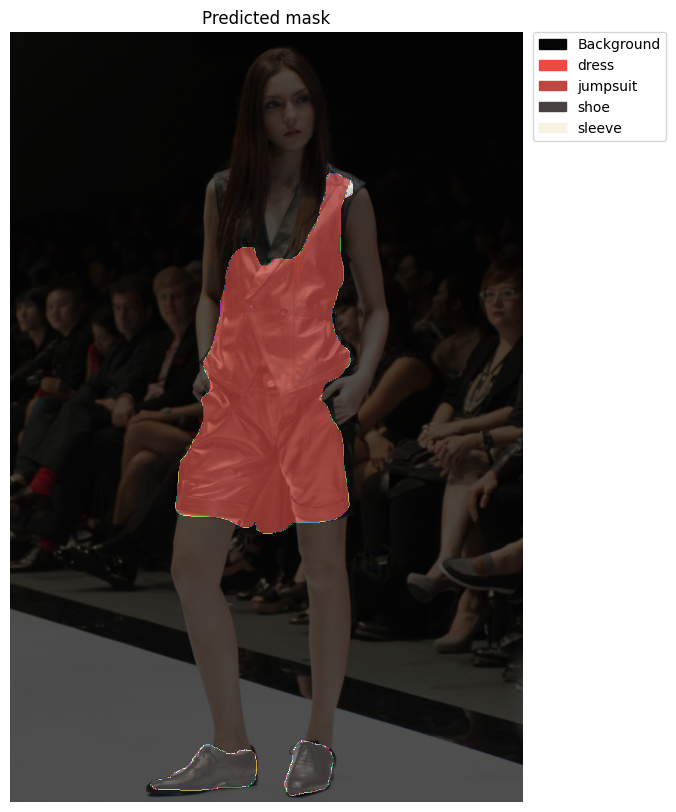

Predicted labels are: ['Background', 'dress', 'jumpsuit', 'shoe', 'sleeve']
----------fa9d0d5edd31d61640e21fafc6aaa2c2----------


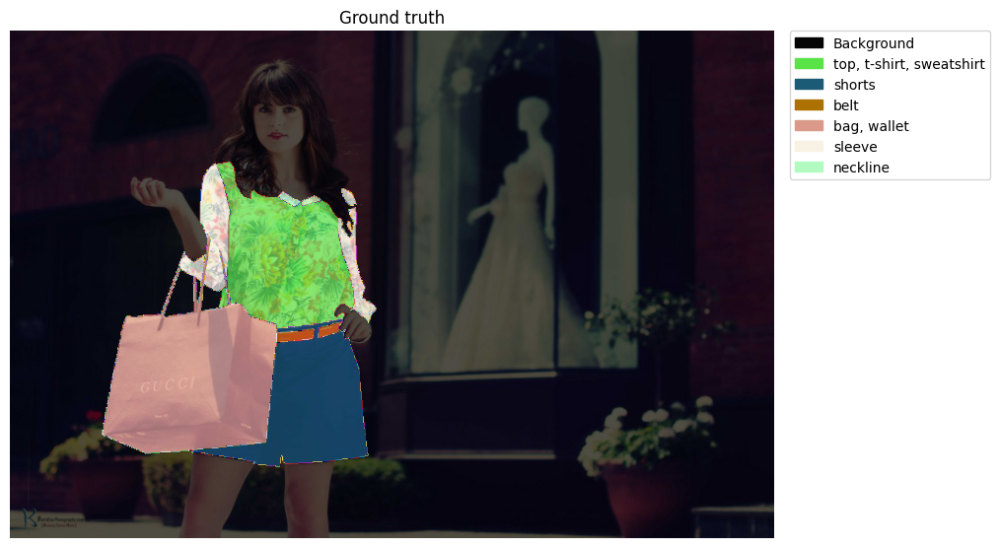

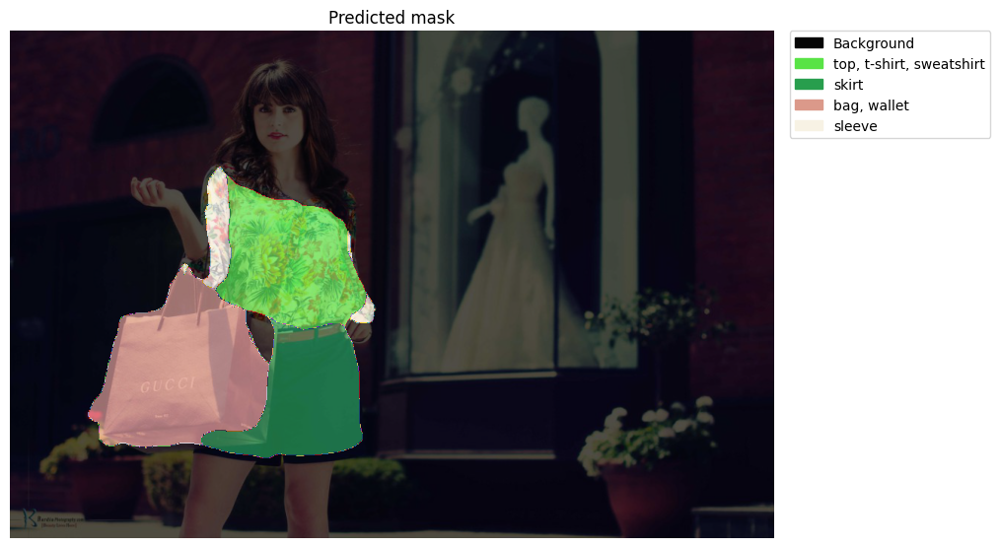

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'skirt', 'bag, wallet', 'sleeve']
----------2ceacea255bd16e687e26a83c5452255----------


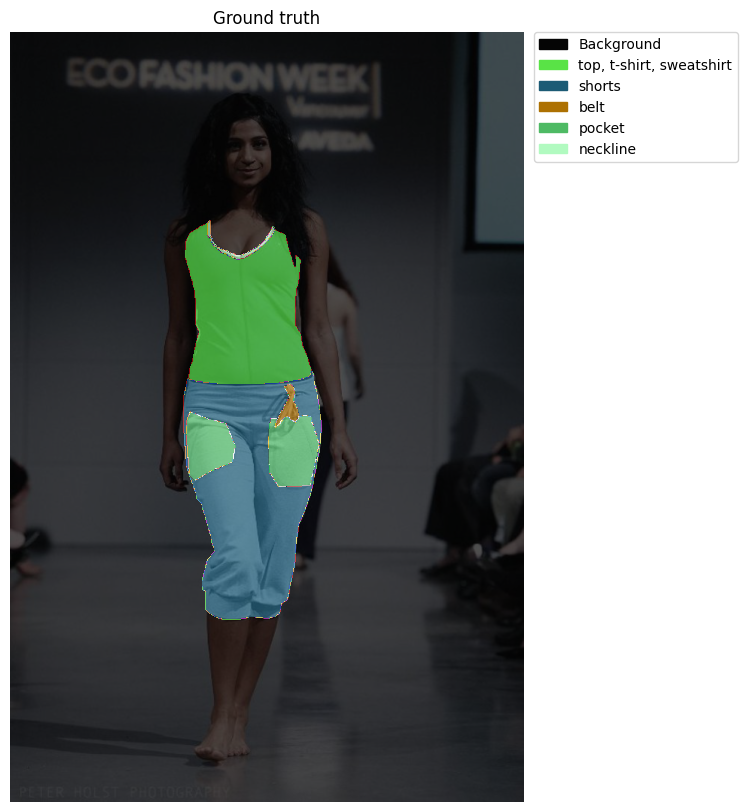

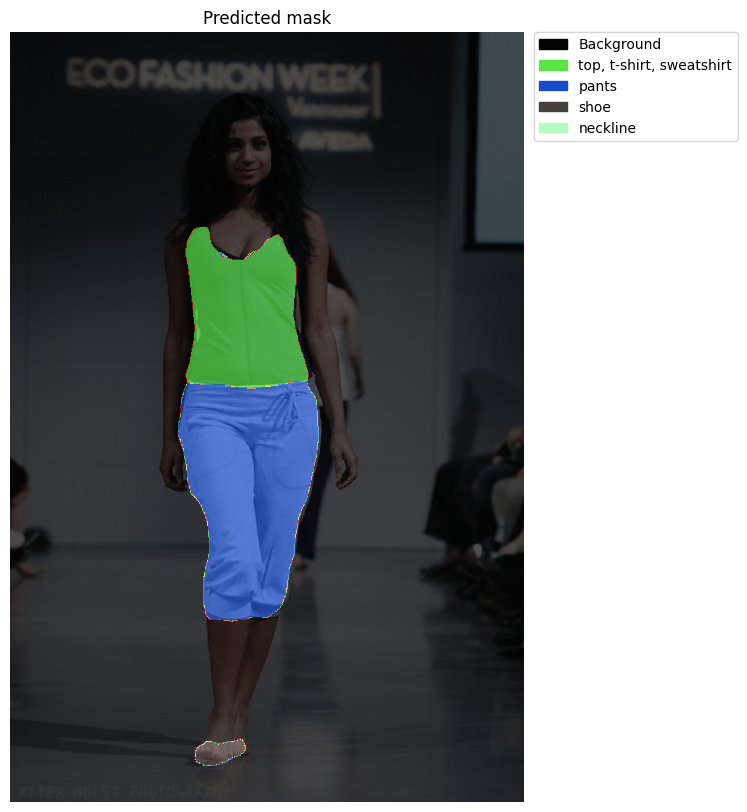

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'pants', 'shoe', 'neckline']
----------39598903e7ffcd5d5ce5354c3a4d2764----------


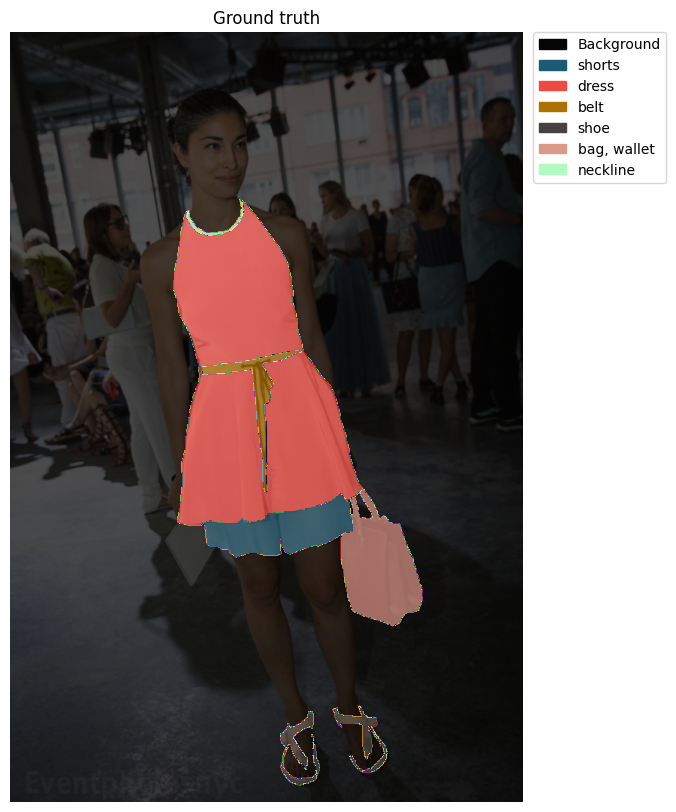

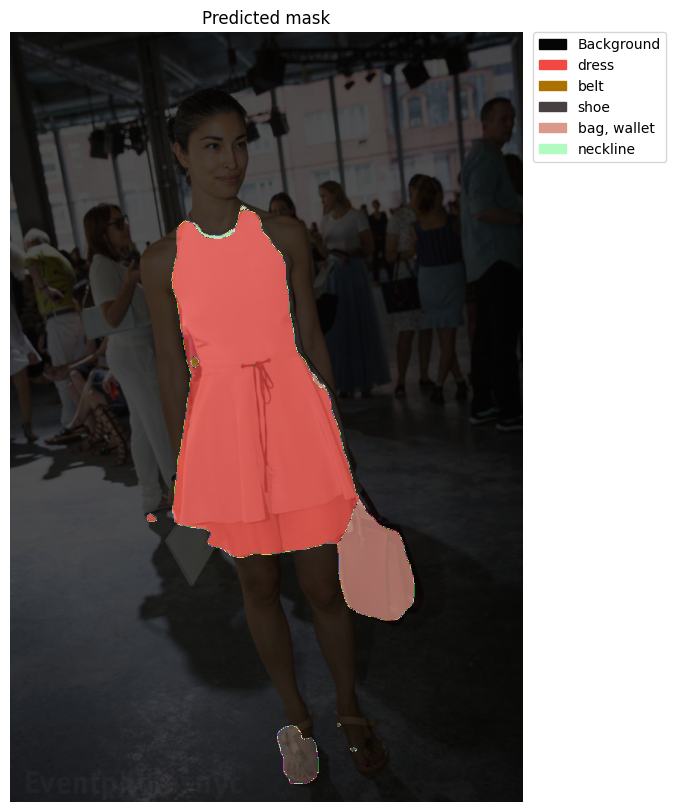

Predicted labels are: ['Background', 'dress', 'belt', 'shoe', 'bag, wallet', 'neckline']
----------5509cbf54887e59f33c40bcbbc78a15b----------


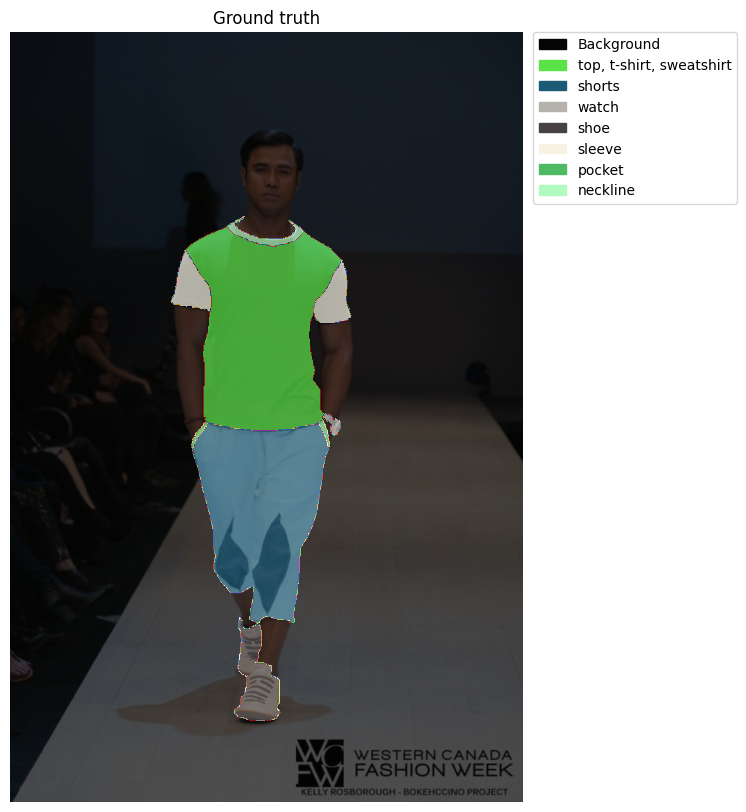

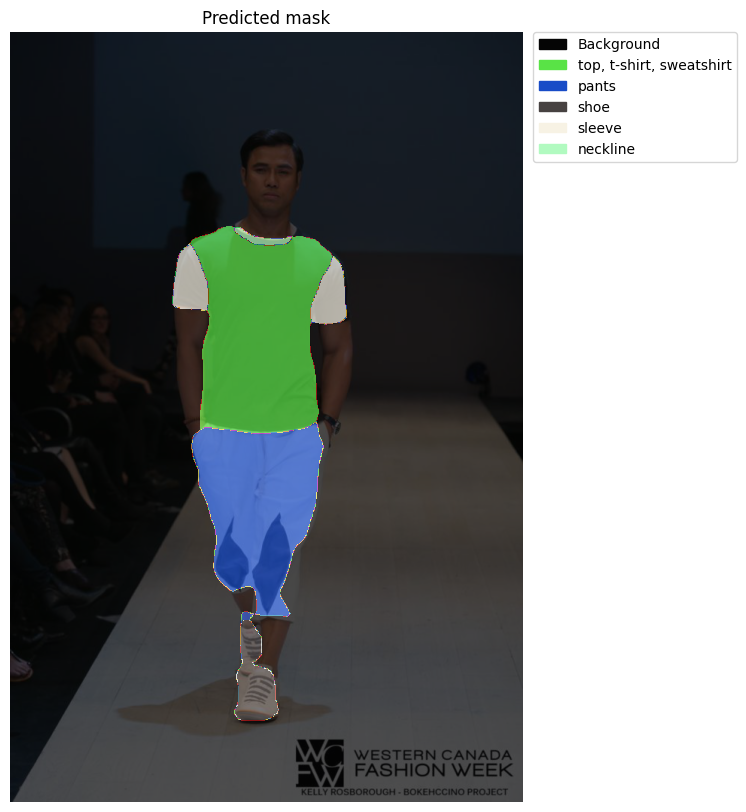

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'pants', 'shoe', 'sleeve', 'neckline']
----------f26668b06a110a0066ed30209c418807----------


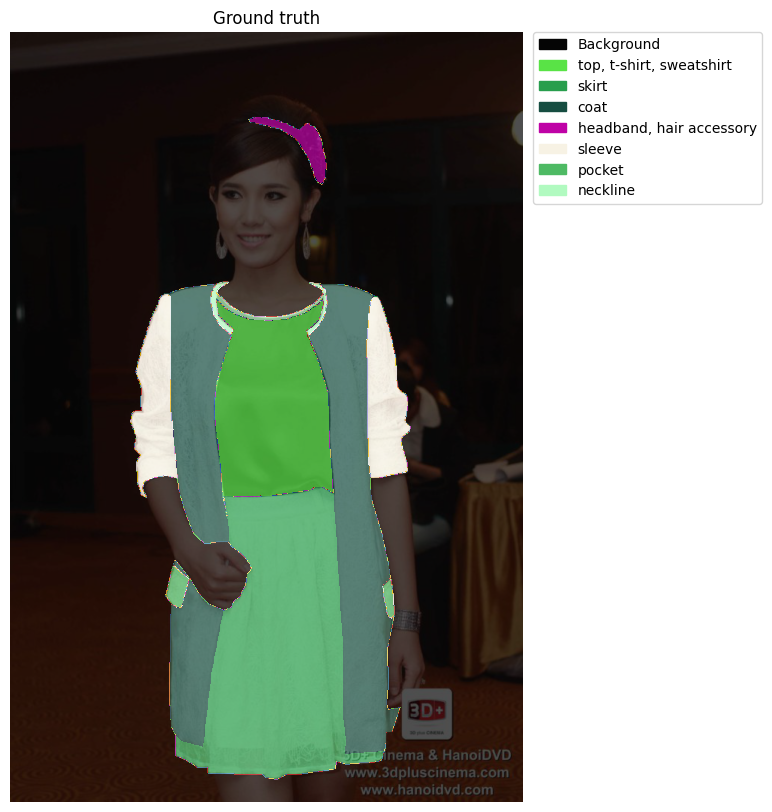

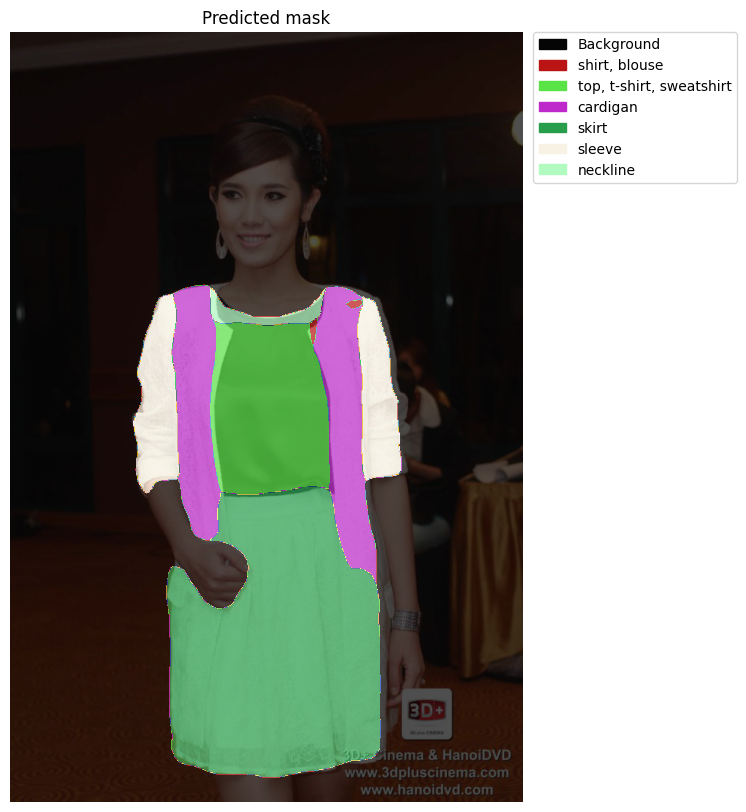

Predicted labels are: ['Background', 'shirt, blouse', 'top, t-shirt, sweatshirt', 'cardigan', 'skirt', 'sleeve', 'neckline']
----------f7d42de488267872bad676577e46b027----------


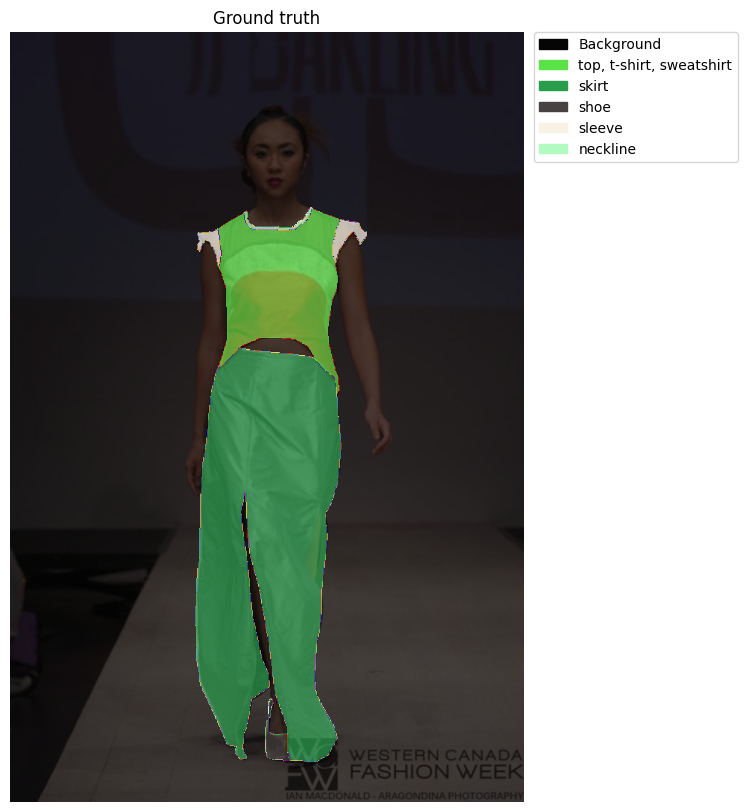

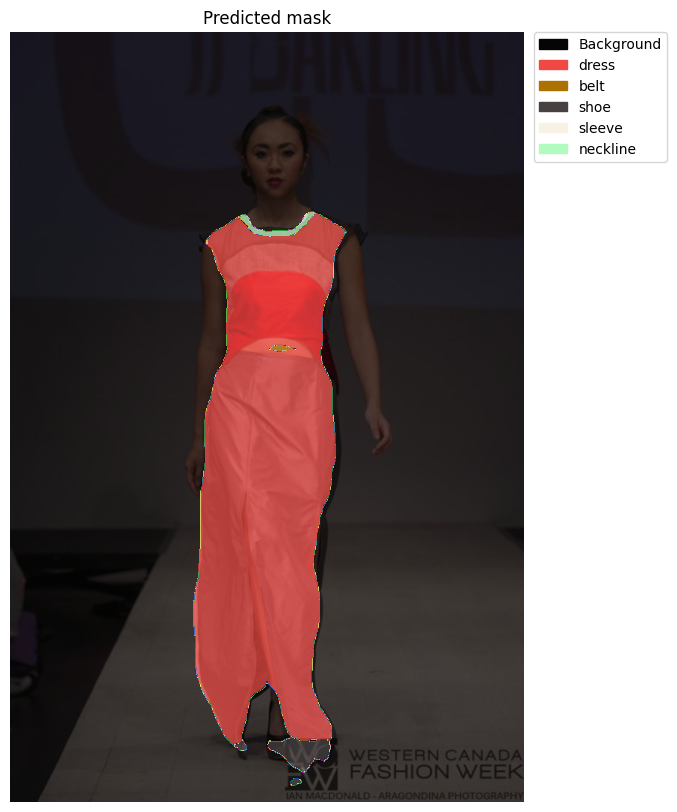

Predicted labels are: ['Background', 'dress', 'belt', 'shoe', 'sleeve', 'neckline']
----------f7f6ae15cf7b430b2bfb95eff751232b----------


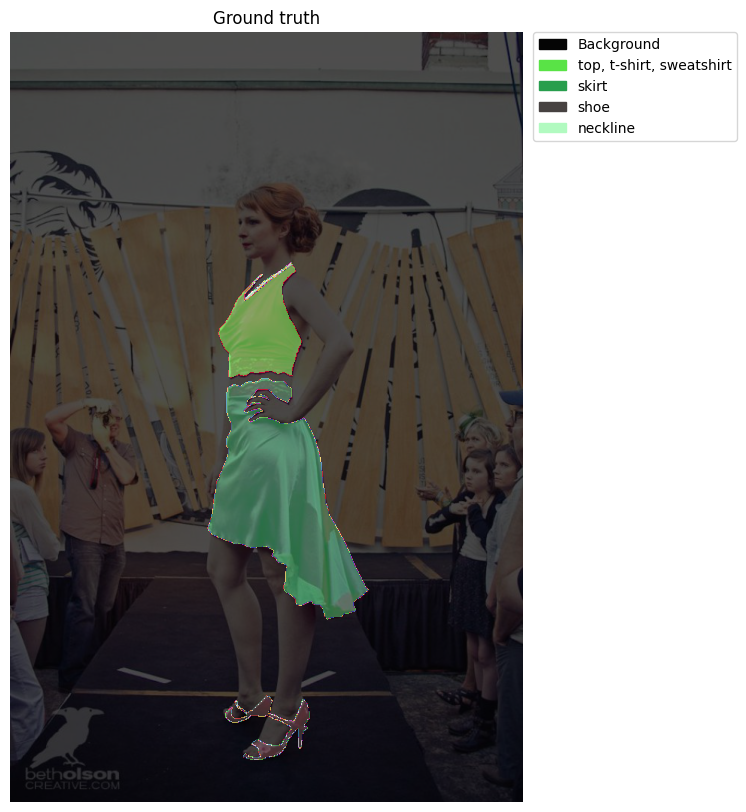

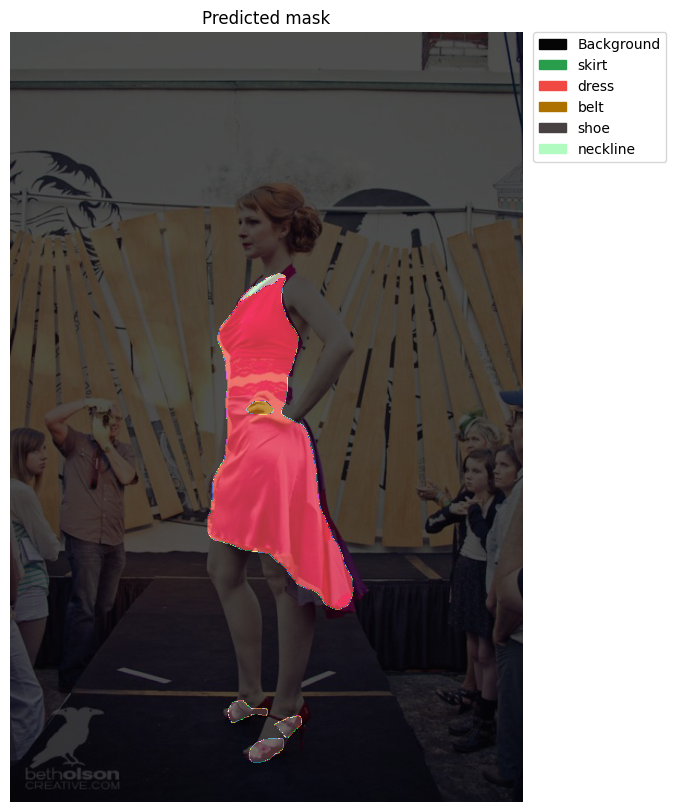

Predicted labels are: ['Background', 'skirt', 'dress', 'belt', 'shoe', 'neckline']
----------228d6f335e7c88d524d4bd4c8bdebd1d----------


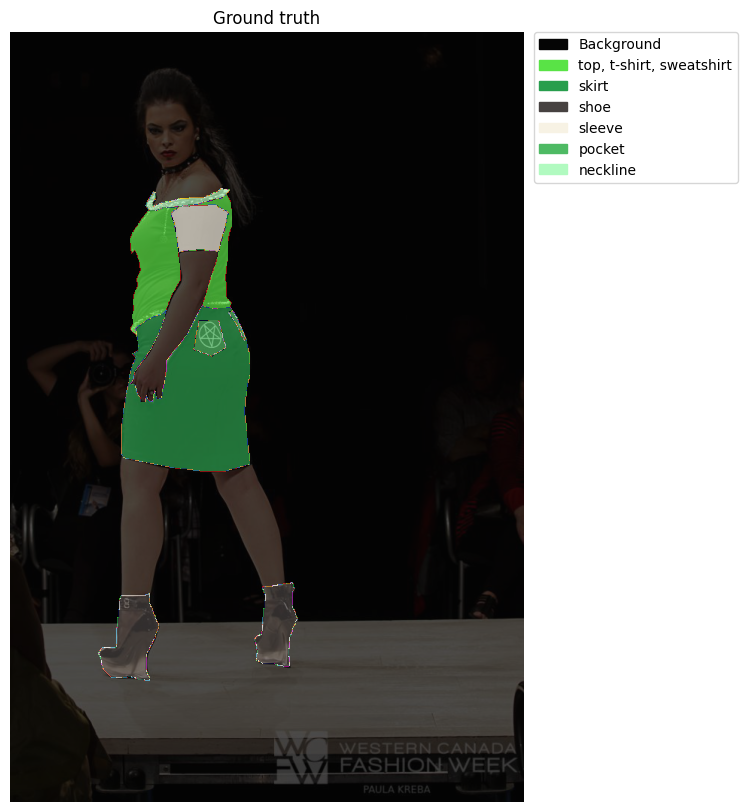

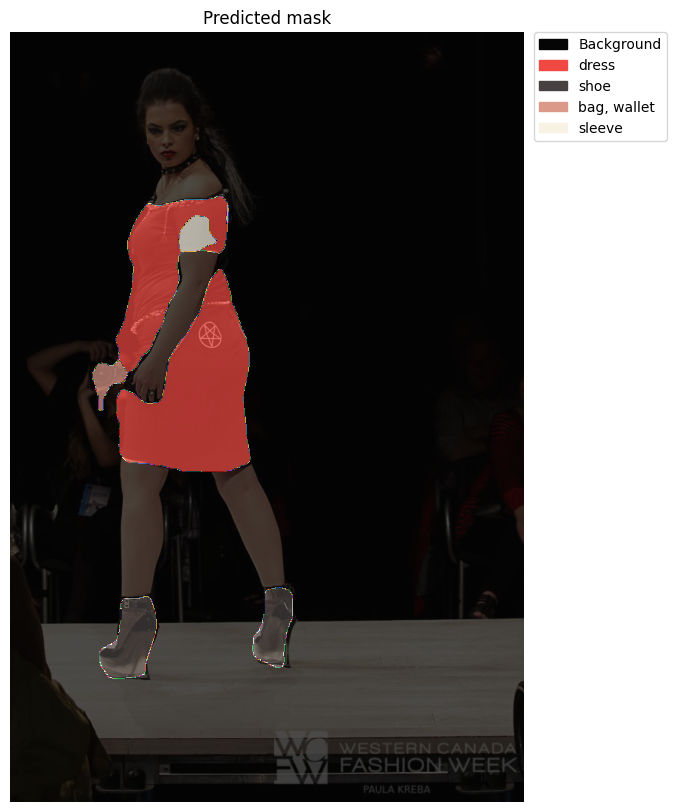

Predicted labels are: ['Background', 'dress', 'shoe', 'bag, wallet', 'sleeve']
----------2adffb322a52bb5e4111ff76b9883f36----------


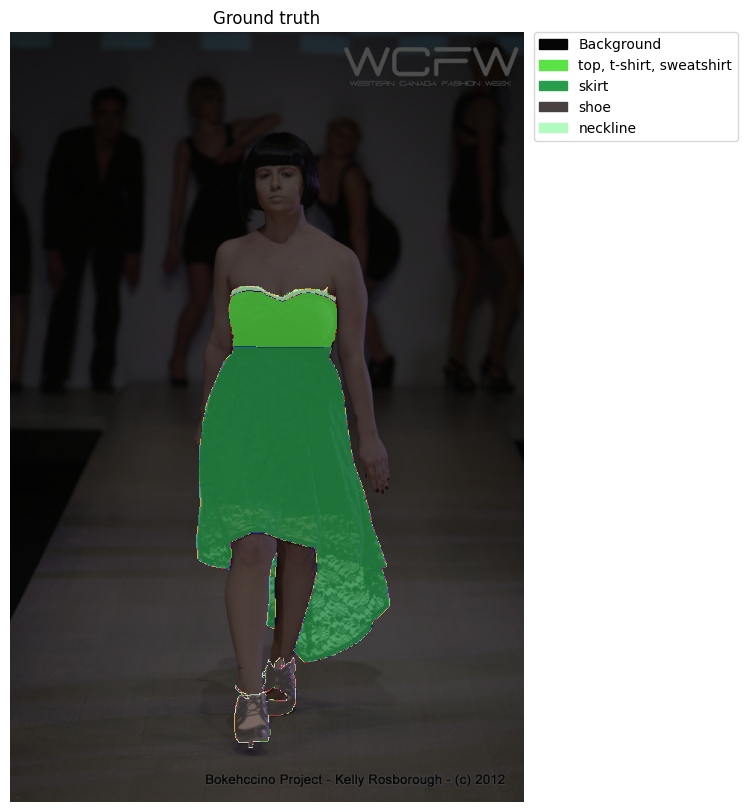

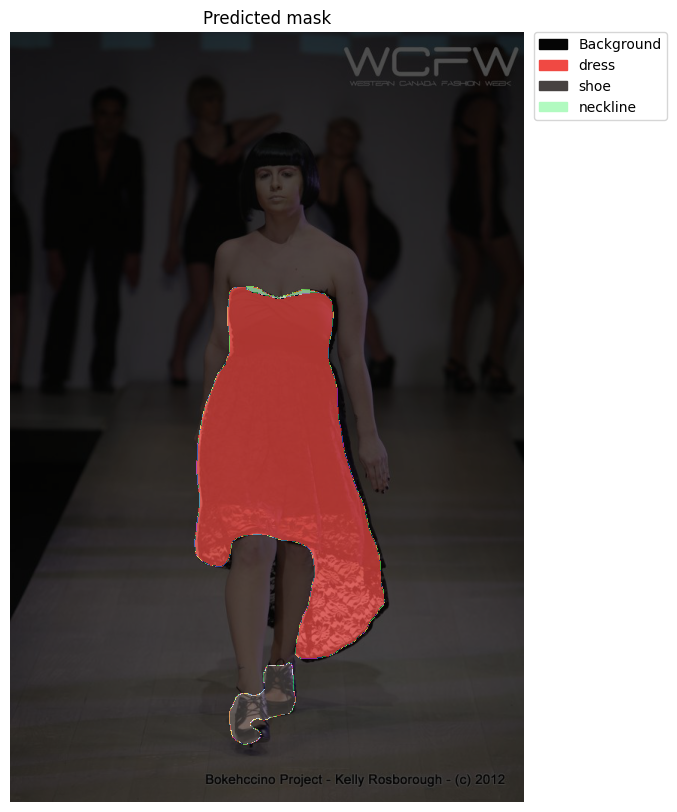

Predicted labels are: ['Background', 'dress', 'shoe', 'neckline']
----------30f78c0b40e3a0cdcd7274a7af53f2ce----------


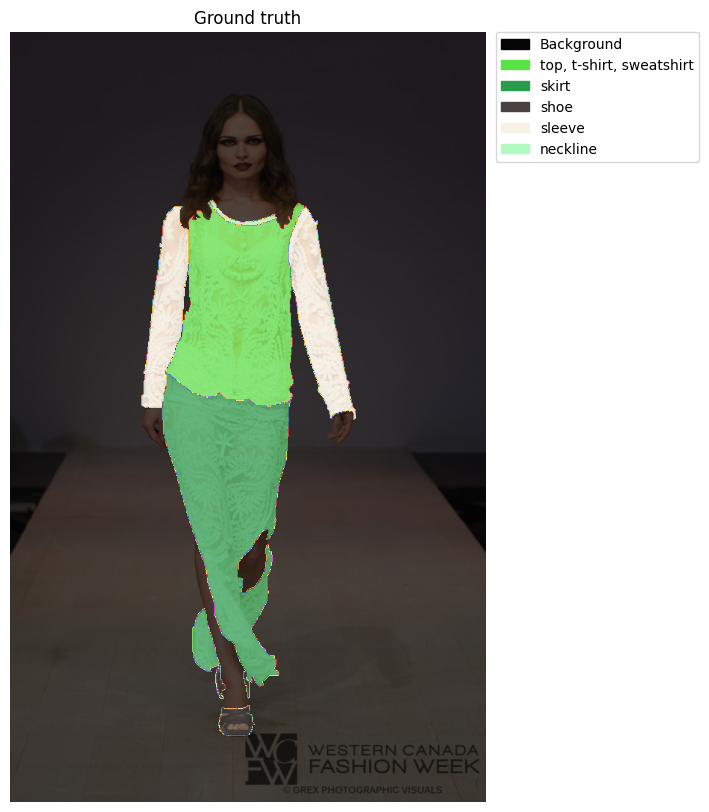

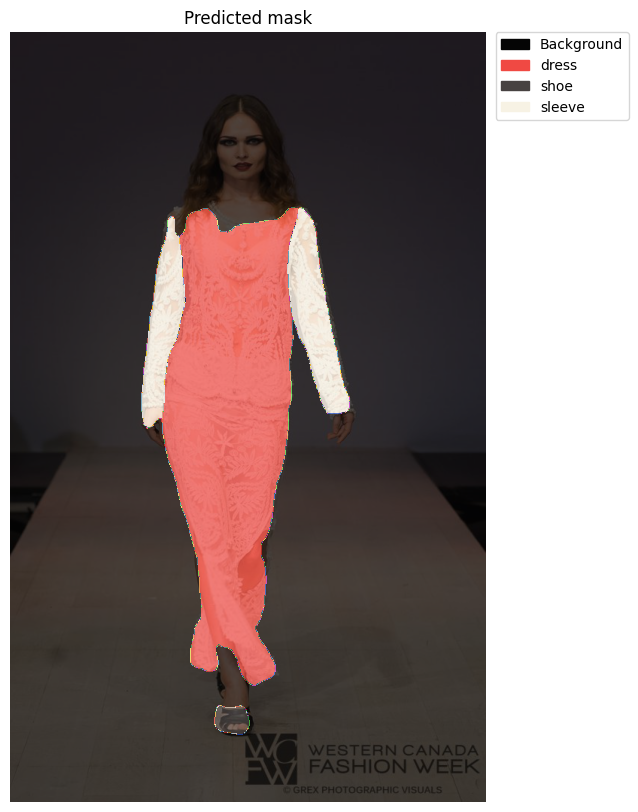

Predicted labels are: ['Background', 'dress', 'shoe', 'sleeve']
----------420f153001eb2e37269ae974b9f7665e----------


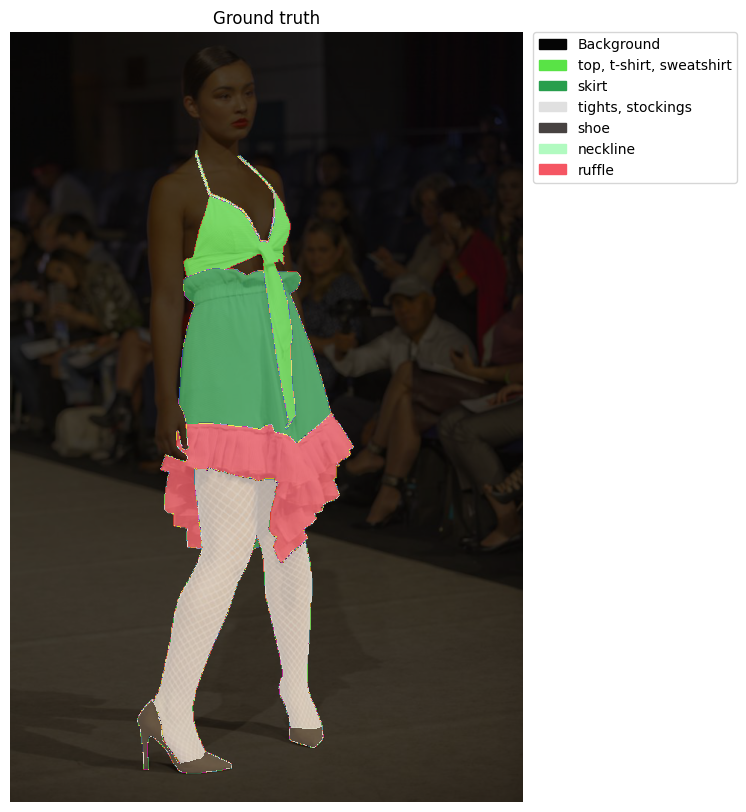

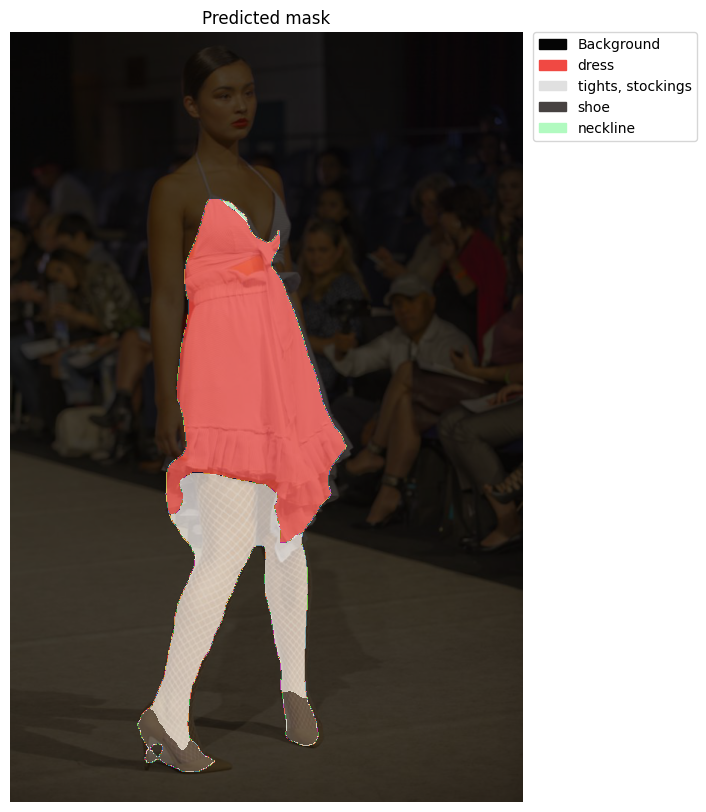

Predicted labels are: ['Background', 'dress', 'tights, stockings', 'shoe', 'neckline']


In [ ]:
# CONFUSIONS:
ims = ['efd0bee7ed5502dcf4e482ddd63c7042', 'fa9d0d5edd31d61640e21fafc6aaa2c2', '2ceacea255bd16e687e26a83c5452255', '39598903e7ffcd5d5ce5354c3a4d2764',
'5509cbf54887e59f33c40bcbbc78a15b', 'f26668b06a110a0066ed30209c418807', 'f7d42de488267872bad676577e46b027', 'f7f6ae15cf7b430b2bfb95eff751232b', 
'228d6f335e7c88d524d4bd4c8bdebd1d', '2adffb322a52bb5e4111ff76b9883f36','30f78c0b40e3a0cdcd7274a7af53f2ce', '420f153001eb2e37269ae974b9f7665e']

for im in ims:
  print('----------'+im+'----------')
  compare_segmentation('/content/val/'+ im +'.jpg', '/content/seg_val/'+ im +'_seg.png')

### Multiperson labels error

----------0fef11157c5630e077ae495f5b708de5----------


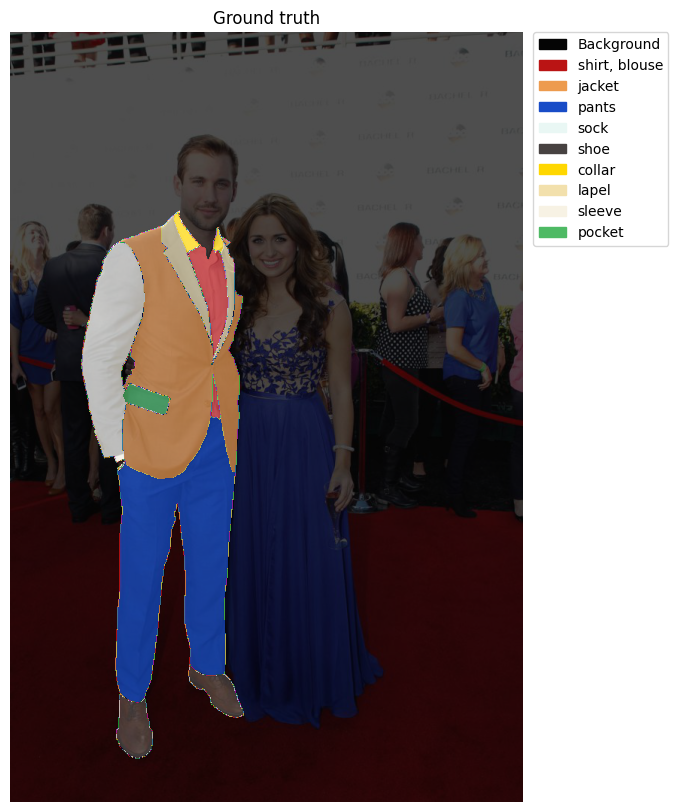

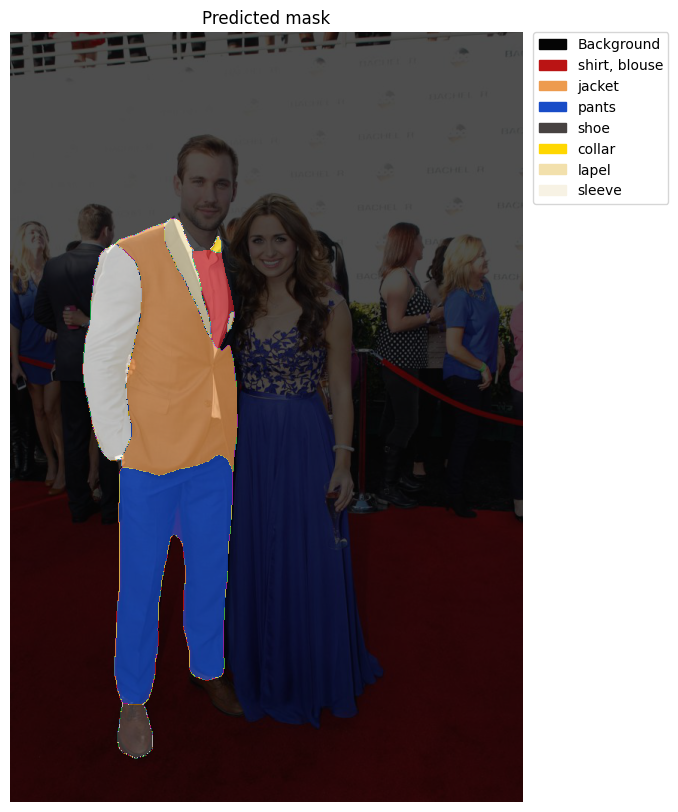

Predicted labels are: ['Background', 'shirt, blouse', 'jacket', 'pants', 'shoe', 'collar', 'lapel', 'sleeve']
----------0d9fbd8432dd8e0b86ea211d42d361fe----------


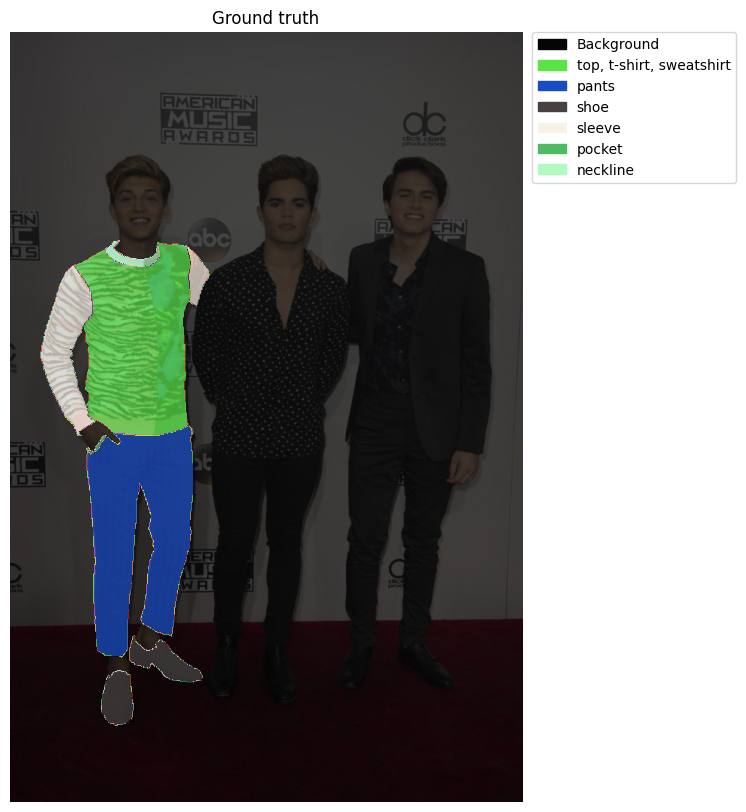

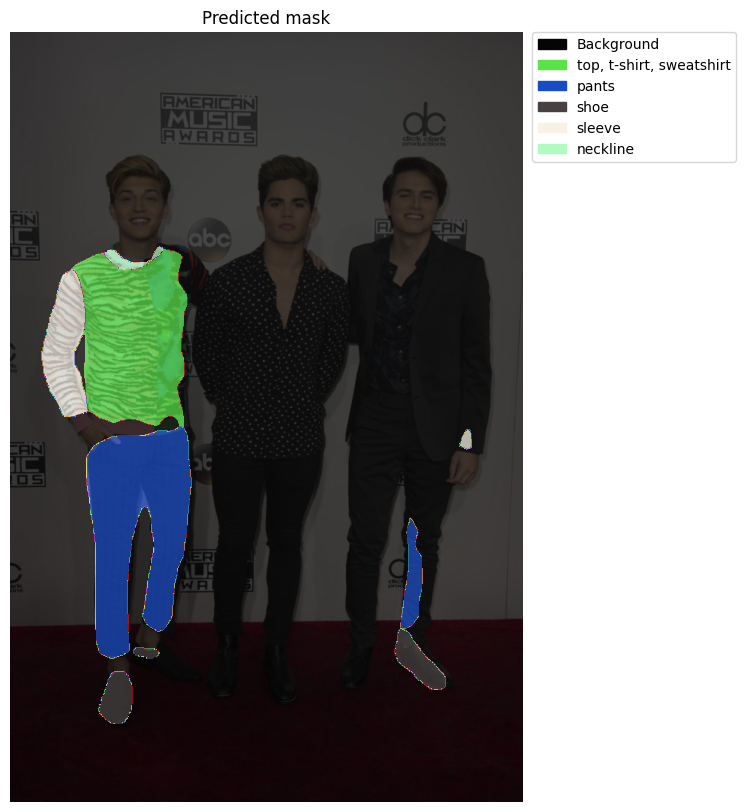

Predicted labels are: ['Background', 'top, t-shirt, sweatshirt', 'pants', 'shoe', 'sleeve', 'neckline']
----------2c657c204ff15e88ffe7585d6d67aefb----------


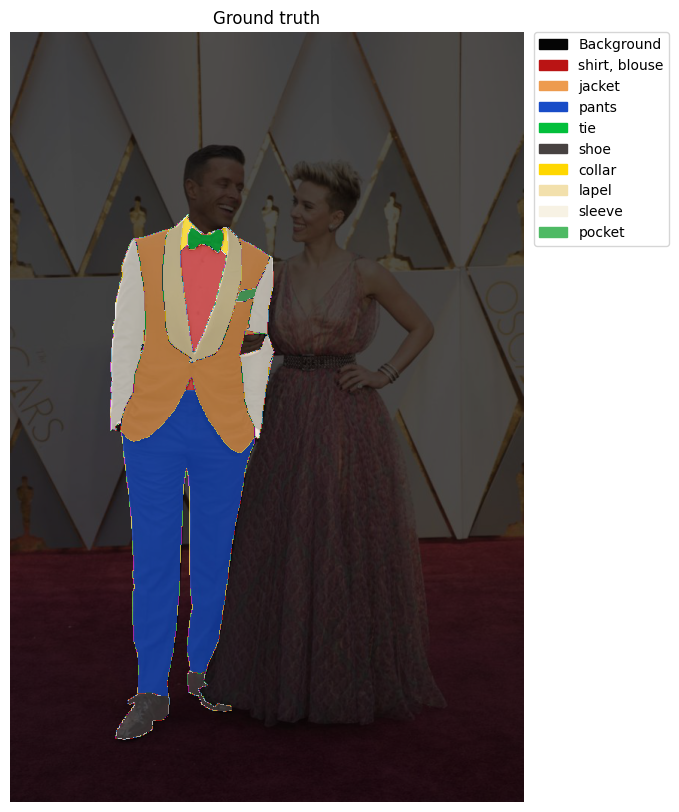

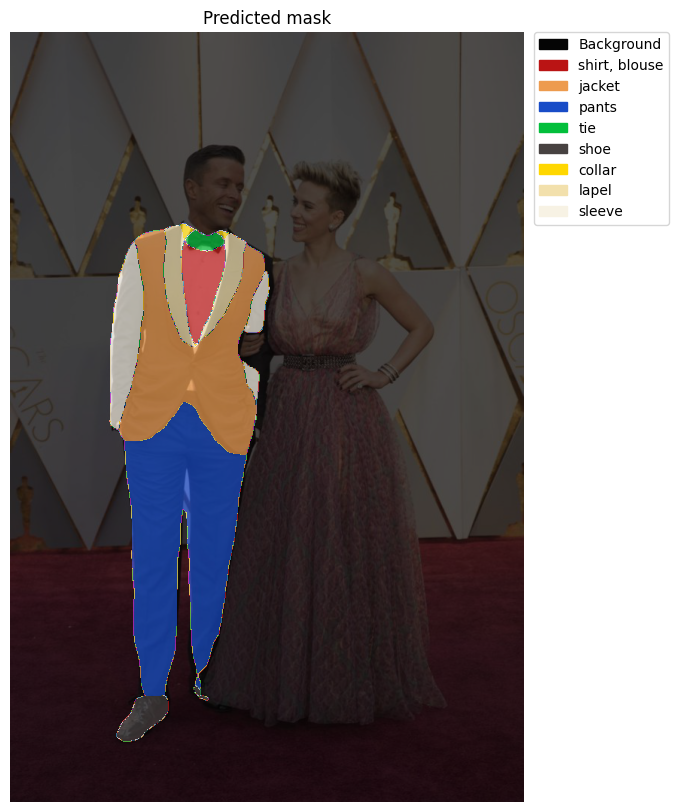

Predicted labels are: ['Background', 'shirt, blouse', 'jacket', 'pants', 'tie', 'shoe', 'collar', 'lapel', 'sleeve']
----------9c0c857621813d0ee54391774371c267----------


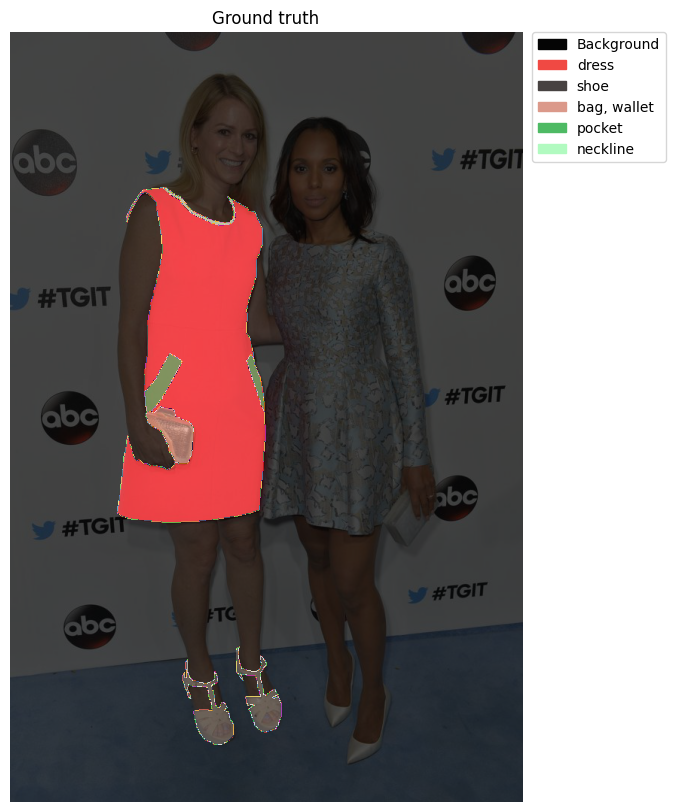

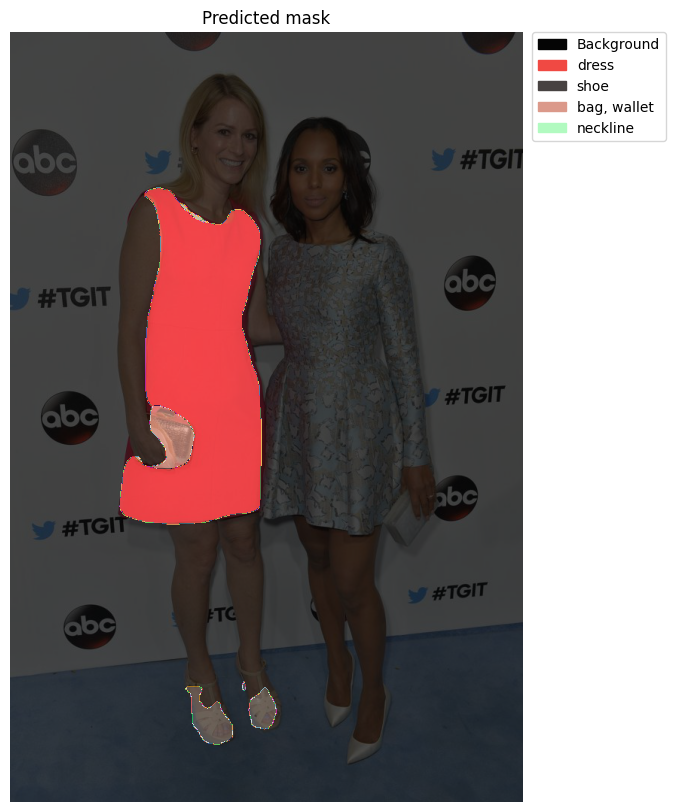

Predicted labels are: ['Background', 'dress', 'shoe', 'bag, wallet', 'neckline']


In [ ]:
mult_im = ['0fef11157c5630e077ae495f5b708de5', '0d9fbd8432dd8e0b86ea211d42d361fe', '2c657c204ff15e88ffe7585d6d67aefb', '9c0c857621813d0ee54391774371c267']
for im in mult_im:
  print('----------'+im+'----------')
  compare_segmentation('/content/train/'+ im +'.jpg', '/content/seg_train/'+ im +'_seg.png')